> data load, data save as pickle

https://pytorch-geometric-temporal.readthedocs.io/en/latest/_modules/index.html



- GNAR warning message 위한 uppressWarnings 

1st

- `ChickenpoxDatasetLoader`
    - get_dataset(self, lags: int = 4) -> StaticGraphTemporalSignal:
- `PedalMeDatasetLoader`
    - get_dataset(self, lags: int = 4) -> StaticGraphTemporalSignal:
- `WikiMathsDatasetLoader`
    - get_dataset(self, lags: int = 8) -> StaticGraphTemporalSignal:
- `WindmillOutputLargeDatasetLoader`, `WindmillOutputMediumDatasetLoader`, `WindmillOutputSmallDatasetLoader`
    - get_dataset(self, lags: int = 8) -> StaticGraphTemporalSignal:
- `MontevideoBusDatasetLoader`
    - get_dataset(self, lags: int = 4, target_var: str = "y", feature_vars: List[str] = ["y"]) -> StaticGraphTemporalSignal:
- dataset = StaticGraphTemporalSignal(self._edges, self._edge_weights, self.features, self.targets)

2nd

- `EnglandCovidDatasetLoader`
    - get_dataset(self, lags: int = 8) -> DynamicGraphTemporalSignal:
    - dataset = DynamicGraphTemporalSignal(self._edges, self._edge_weights, self.features, self.targets)

3rd

- `METRLADatasetLoader`
    - get_dataset(self, num_timesteps_in: int = 12, num_timesteps_out: int = 12) -> StaticGraphTemporalSignal:
- `PemsBayDatasetLoader`
    - get_dataset(self, num_timesteps_in: int = 12, num_timesteps_out: int = 12) -> StaticGraphTemporalSignal:
- dataset = StaticGraphTemporalSignal(self.edges, self.edge_weights, self.features, self.targets)

4rd

- `MTMDatasetLoader`
    - get_dataset(self, frames: int = 16) -> StaticGraphTemporalSignal:
    - dataset = StaticGraphTemporalSignal(=self._edges, self._edge_weights, self.features, self.targets)

5th
- `TwitterTennisDatasetLoader`(원핫 인코딩 함수도 별도로 있음)
    - get_dataset(self) -> DynamicGraphTemporalSignal:
    - dataset = DynamicGraphTemporalSignal(self.edges, self.edge_weights, self.features, self.target

# Import

In [204]:
import numpy as np

In [205]:
import networkx as nx

In [206]:
import json
import urllib

In [207]:
import matplotlib.pyplot as plt
import random

In [208]:
def load_data(fname):
    with open(fname, 'rb') as outfile:
        data_dict = pickle.load(outfile)
    return data_dict

In [209]:
def save_data(data_dict,fname):
    with open(fname,'wb') as outfile:
        pickle.dump(data_dict,outfile)

In [210]:
import torch
import torch.nn.functional as F
from torch_geometric_temporal.nn.recurrent import GConvGRU

class RecurrentGCN(torch.nn.Module):
    def __init__(self, node_features, filters):
        super(RecurrentGCN, self).__init__()
        self.recurrent = GConvGRU(node_features, filters, 2)
        self.linear = torch.nn.Linear(filters, 1)

    def forward(self, x, edge_index, edge_weight):
        h = self.recurrent(x, edge_index, edge_weight)
        h = F.relu(h)
        h = self.linear(h)
        return h

In [211]:
import pickle

In [12]:
# save_data(df_gnar, './data/EnglandCovid_gnar_randomly_by_rate.pkl')

In [13]:
# load_data('./data/GNAR_stgcn_randomly_by_rate.pkl')

```
!git add .
!git commit -m .
!git push 
!quarto publish --no-browser --no-prompt 
```

In [14]:
# _data = load_data('./_data/fivenodes.pkl')

In [15]:
import torch

In [30]:
# _edges = torch.tensor(_data['edges']).nonzero().tolist()
# _FX = _data['f'].tolist()
# _node_ids = {'node1':0, 'node2':1, 'node3':2, 'node4':3, 'node5':4} 

In [31]:
# data_dict = {'edges':_edges, 'node_ids':_node_ids, 'FX':_FX}
# #data_dict = itstgcn.load_data('./data/fivenodes.pkl')

In [32]:
# save_data(data_dict, './data/fivenodes.pkl')

In [33]:
# load_data('./data/GNAR_stgcn_randomly_by_rate.pkl')

In [259]:
import plotly.graph_objects as go


In [311]:
import plotly.express as px

In [ ]:
loader6

In [654]:
# save_data(loader6, './data/Windmillsmall.pkl')

In [33]:
# load_data('./data/Windmillsmall.pkl')

# fivenodes

In [407]:
import itstgcn

In [516]:
data_dict = itstgcn.load_data('./data/fivenodes.pkl')
loader = itstgcn.DatasetLoader(data_dict)

In [517]:
a = loader.get_dataset(lags=1)

In [518]:
np.array(a.features).shape

(199, 5, 1)

In [519]:
np.array(a.edge_index).shape

(2, 10)

In [520]:
np.array(a.edge_weight).shape

(10,)

In [521]:
a.edge_weight

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

In [522]:
a.edge_index

array([[0, 0, 1, 1, 2, 2, 3, 3, 3, 4],
       [3, 4, 2, 3, 1, 3, 0, 1, 2, 0]])

In [523]:
G = nx.Graph()

In [524]:
G.add_edges_from(a.edge_index.T)

In [525]:
nx.draw_networkx?

Signature: nx.draw_networkx(G, pos=None, arrows=None, with_labels=True, **kwds)
Docstring:
Draw the graph G using Matplotlib.

Draw the graph with Matplotlib with options for node positions,
labeling, titles, and many other drawing features.
See draw() for simple drawing without labels or axes.

Parameters
----------
G : graph
    A networkx graph

pos : dictionary, optional
    A dictionary with nodes as keys and positions as values.
    If not specified a spring layout positioning will be computed.
    See :py:mod:`networkx.drawing.layout` for functions that
    compute node positions.

arrows : bool or None, optional (default=None)
    If `None`, directed graphs draw arrowheads with
    `~matplotlib.patches.FancyArrowPatch`, while undirected graphs draw edges
    via `~matplotlib.collections.LineCollection` for speed.
    If `True`, draw arrowheads with FancyArrowPatches (bendable and stylish).
    If `False`, draw edges using LineCollection (linear and fast).
    For directed graph

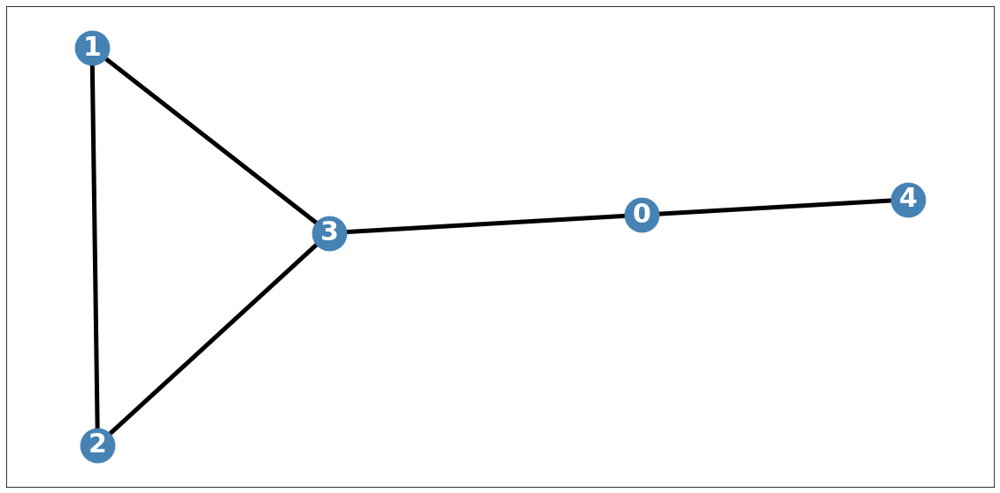

In [192]:
plt.figure(figsize=(20, 10)) 
nx.draw_networkx(G, with_labels=True, font_weight='bold', node_color='steelblue', node_size=1500, font_color='white', font_size=30,width=5)
plt.savefig("graph_node_ex.png")

In [148]:
node_list = []
for i in range(0, 5):
    node_list.append(i)

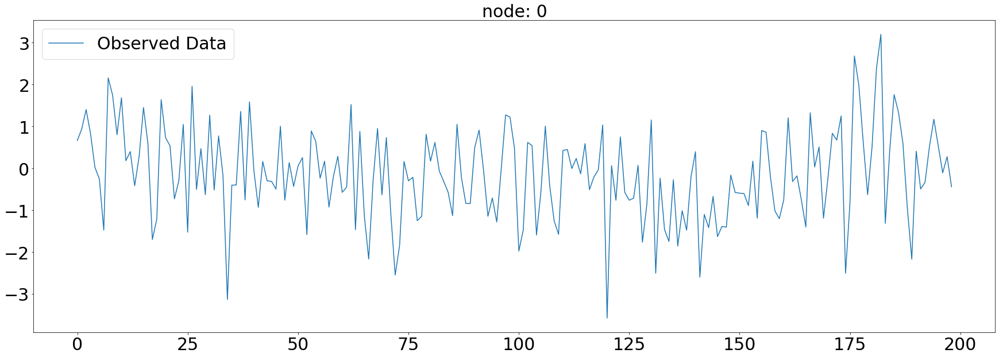

In [193]:
plt.subplots(1,1,figsize=(30,10))
plt.plot(np.array(loader.targets).reshape(5,-1)[0][:],alpha=1,label='Observed Data')
plt.title('node: {}'.format(node_list[0]),fontsize=30)
plt.tick_params(axis='y', labelsize=30)
plt.tick_params(axis='x', labelsize=30)
plt.legend(fontsize=30,loc='upper left',facecolor='white', frameon=True)
fig.tight_layout()
# plt.savefig("graph_node_ex_0.png")

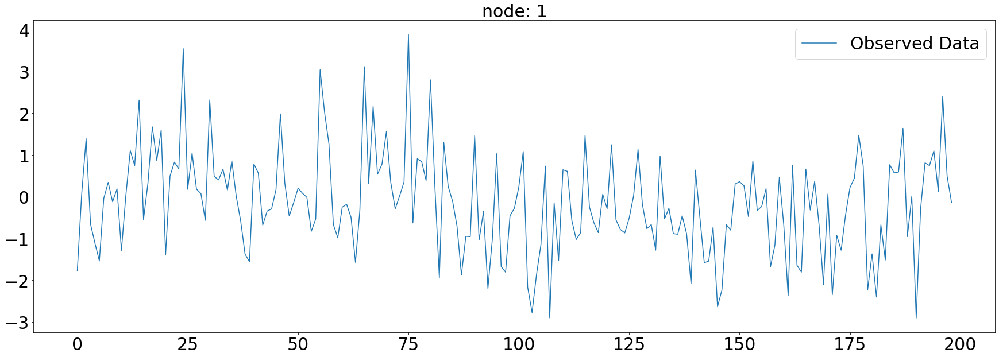

In [159]:
plt.subplots(1,1,figsize=(30,10))
plt.plot(np.array(loader.targets).reshape(5,-1)[1][:],alpha=1,label='Observed Data')
plt.title('node: {}'.format(node_list[1]),fontsize=30)
plt.tick_params(axis='y', labelsize=30)
plt.tick_params(axis='x', labelsize=30)
plt.legend(fontsize=30,loc='upper right',facecolor='white', frameon=True)
fig.tight_layout()
plt.savefig("graph_node_ex_1.png")

In [195]:
import copy

In [197]:
_target = np.array(loader.targets).reshape(5,-1)[2].copy()

In [201]:
_target[50:150] = None

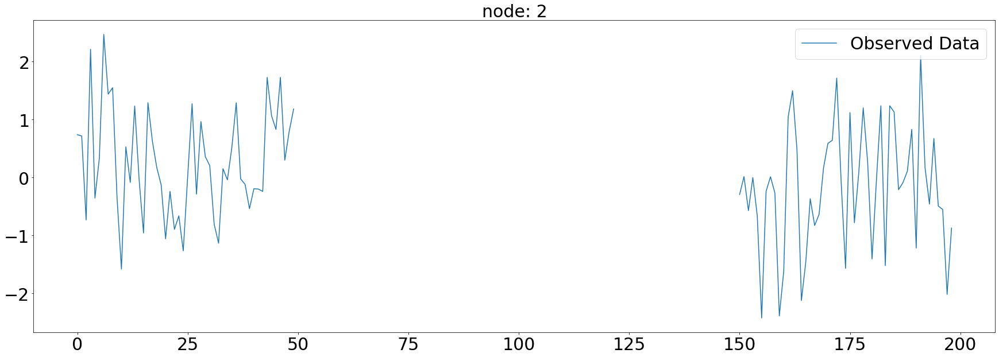

In [203]:
plt.subplots(1,1,figsize=(30,10))
plt.plot(_target,alpha=1,label='Observed Data')
plt.title('node: {}'.format(node_list[2]),fontsize=30)
plt.tick_params(axis='y', labelsize=30)
plt.tick_params(axis='x', labelsize=30)
plt.legend(fontsize=30,loc='upper right',facecolor='white', frameon=True)
fig.tight_layout()
plt.savefig("graph_node_ex_2.png")

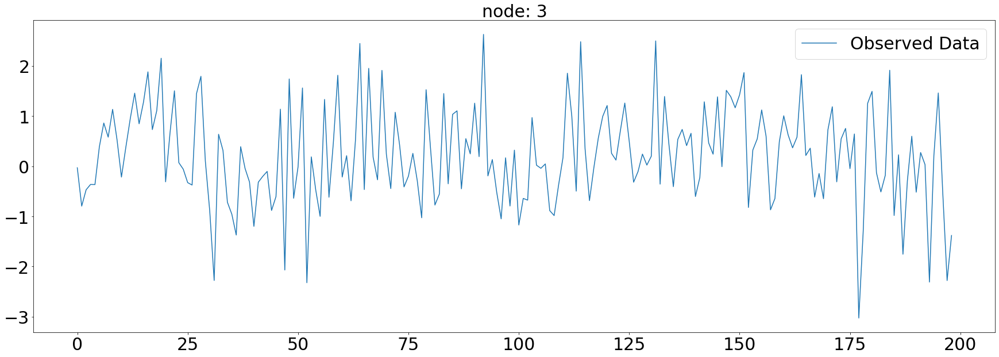

In [157]:
plt.subplots(1,1,figsize=(30,10))
plt.plot(np.array(loader.targets).reshape(5,-1)[3][:],alpha=1,label='Observed Data')
plt.title('node: {}'.format(node_list[3]),fontsize=30)
plt.tick_params(axis='y', labelsize=30)
plt.tick_params(axis='x', labelsize=30)
plt.legend(fontsize=30,loc='upper right',facecolor='white', frameon=True)
fig.tight_layout()
plt.savefig("graph_node_ex_3.png")

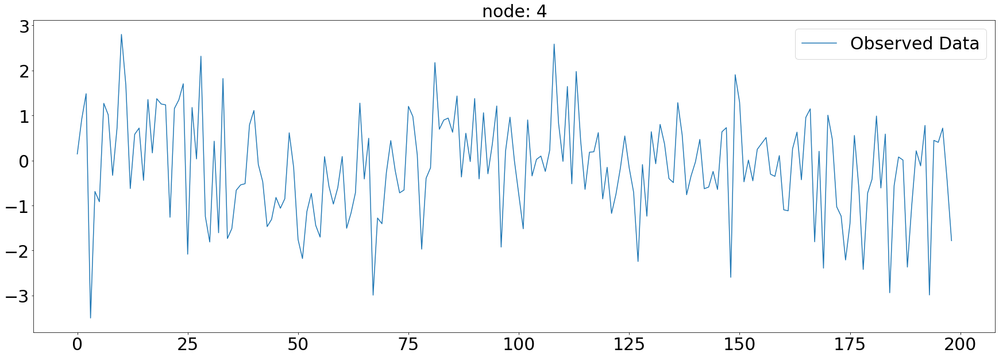

In [156]:
plt.subplots(1,1,figsize=(30,10))
plt.plot(np.array(loader.targets).reshape(5,-1)[4][:],label='Observed Data')
plt.title('node: {}'.format(node_list[4]),fontsize=30)
plt.tick_params(axis='y', labelsize=30)
plt.tick_params(axis='x', labelsize=30)
plt.legend(fontsize=30,loc='upper right',facecolor='white', frameon=True)
fig.tight_layout()
plt.savefig("graph_node_ex_4.png")

In [475]:
x = list(range(a.snapshot_count))
y1 = np.array(a.features)[:, 0, :].reshape(-1)
y2 = np.array(a.features)[:, 1, :].reshape(-1)
y3 = np.array(a.features)[:, 2, :].reshape(-1)
y4 = np.array(a.features)[:, 3, :].reshape(-1)
y5 = np.array(a.features)[:, 4, :].reshape(-1)

_df = pd.DataFrame({'x': x, 'y1': y1, 'y2': y2, 'y3': y3, 'y4': y4, 'y5': y5})

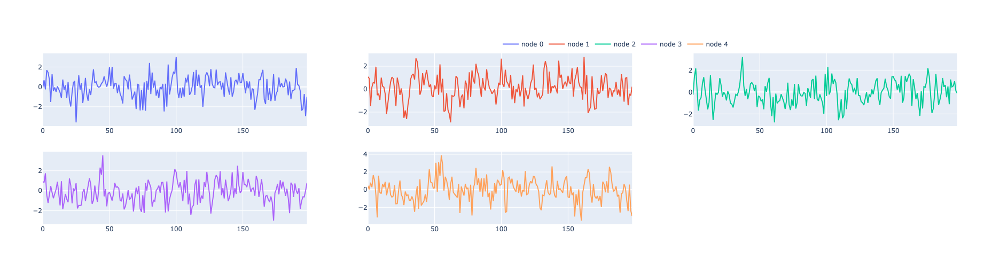

In [476]:
fig = make_subplots(rows=2, cols=3)

# 각 서브플롯에 선 그래프 추가
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y1'], mode='lines', name='node 0'), row=1, col=1)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y2'], mode='lines', name='node 1'), row=1, col=2)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y3'], mode='lines', name='node 2'), row=1, col=3)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y4'], mode='lines', name='node 3'), row=2, col=1)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y5'], mode='lines', name='node 4'), row=2, col=2)

# 그래프 크기 조정
fig.update_layout(width=1000, height=500, legend=dict(x=0.5, y=1.1, orientation='h'))

# 그래프 출력
fig.show()

In [424]:
with open('fig_fivenodes.pkl', 'wb') as file:
    pickle.dump(fig, file)

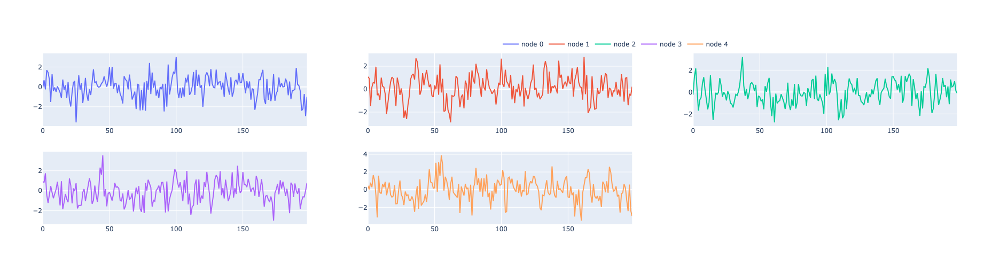

In [425]:
with open("fig_fivenodes.pkl", "rb") as file:
    loaded_object1 = pickle.load(file)

loaded_object1

## ChickenpoxDatasetLoader

Chickenpox Hungary

- A dataset of county level chicken pox cases in Hungary between 2004 and 2014. We made it public during the development of PyTorch Geometric Temporal. The underlying graph is static - vertices are counties and edges are neighbourhoods. Vertex features are lagged weekly counts of the chickenpox cases (we included 4 lags). The target is the weekly number of cases for the upcoming week (signed integers). Our dataset consist of more than 500 snapshots (weeks).
- 2004년부터 2014년 사이 헝가리의 지역별 수두증 발생 데이터셋
- 그래프는 정적
- node 지역
- edge 이웃 관계
- node 특성은 수두증 발생의 지연된 주간 횟수(4주의 지연이 포함되어 있음)
- target는 다음 주에 대한 주간 사례 수
- 500개 이상의 스냅샷(주간)

데이터정리 

- T = 519
- N = 20 # number of nodes 
- E = 102 # edges 
- $f(v,t)$의 차원? (1,)
- 시간에 따라서 Number of nodes가 변하는지? False
- 시간에 따라서 Number of nodes가 변하는지? False
- X: (20,4) (N,4), $f(v,t_0),f(v,t_1),f(v,t_2),f(v,t_3)$
- y: (20,) (N,), $f(v,t_4)$
- 예제코드적용가능여부: Yes

`-` Nodes : `20`

- vertices are counties

`-`Edges : `102`

- edges are neighbourhoods

`-` Time : `517`

- between 2004 and 2014
- per weeks

In [640]:
from torch_geometric_temporal.dataset import ChickenpoxDatasetLoader
loader1 = ChickenpoxDatasetLoader()

In [641]:
a = loader1.get_dataset(lags=1)

In [642]:
np.array(a.features).shape

(520, 20, 1)

In [643]:
np.array(a.edge_index).shape

(2, 102)

In [644]:
np.array(a.edge_weight).shape

(102,)

In [645]:
a.edge_weight

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

In [646]:
a.edge_index

array([[ 0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  2,  2,  2,  2,  3,
         3,  3,  3,  3,  3,  4,  4,  5,  5,  5,  5,  6,  6,  6,  6,  6,
         6,  6,  7,  7,  7,  7,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,
        10, 10, 10, 10, 10, 10, 10, 10, 11, 11, 11, 11, 11, 12, 12, 12,
        12, 13, 13, 13, 13, 13, 13, 13, 13, 14, 14, 14, 14, 14, 14, 15,
        15, 15, 16, 16, 16, 16, 16, 17, 17, 17, 17, 18, 18, 18, 18, 18,
        18, 18, 19, 19, 19, 19],
       [10,  6, 13,  1,  0,  5, 16,  0, 16,  1, 14, 10,  8,  2,  5,  8,
        15, 12,  9, 10,  3,  4, 13,  0, 10,  2,  5,  0, 16,  6, 14, 13,
        11, 18,  7, 17, 11, 18,  3,  2, 15,  8, 10,  9, 13,  3, 12, 10,
         5,  9,  8,  3, 10,  2, 13,  0,  6, 11,  7, 13, 18,  3,  9, 13,
        12, 13,  9,  6,  4, 12,  0, 11, 10, 18, 19,  1, 14,  6, 16,  3,
        15,  8, 16, 14,  1,  0,  6,  7, 19, 17, 18, 14, 18, 17,  7,  6,
        19, 11, 18, 14, 19, 17]])

In [647]:
G = nx.Graph()

In [648]:
G.add_edges_from(a.edge_index.T)

In [649]:
from haversine import haversine

In [650]:
haversine?

Signature:
haversine(
    point1,
    point2,
    unit=<Unit.KILOMETERS: 'km'>,
    normalize=False,
    check=True,
)
Docstring:
Calculate the great-circle distance between two points on the Earth surface.

Takes two 2-tuples, containing the latitude and longitude of each point in decimal degrees,
and, optionally, a unit of length.

:param point1: first point; tuple of (latitude, longitude) in decimal degrees
:param point2: second point; tuple of (latitude, longitude) in decimal degrees
:param unit: a member of haversine.Unit, or, equivalently, a string containing the
             initials of its corresponding unit of measurement (i.e. miles = mi)
             default 'km' (kilometers).
:param normalize: if True, normalize the points to [-90, 90] latitude and [-180, 180] longitude.
:param check: if True, check that points are normalized.

Example: ``haversine((45.7597, 4.8422), (48.8567, 2.3508), unit=Unit.METERS)``

Precondition: ``unit`` is a supported unit (supported units are list

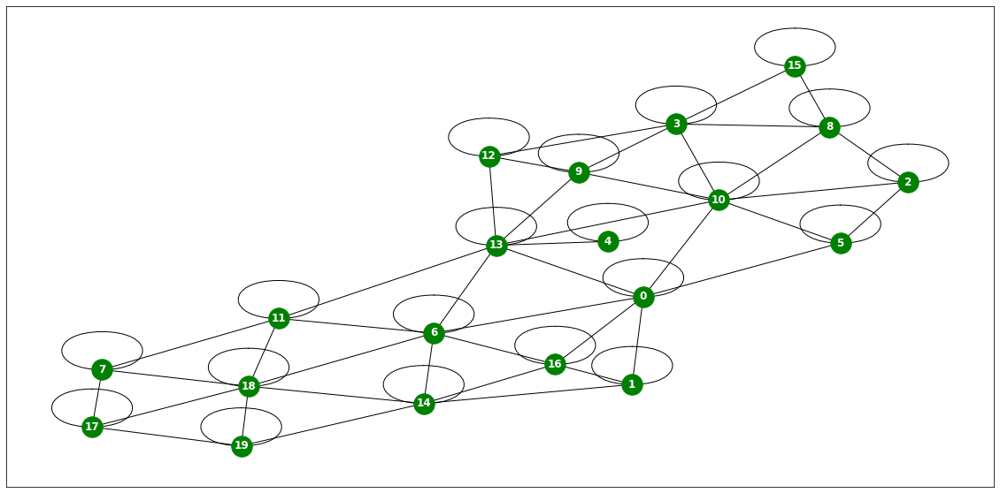

In [651]:
plt.figure(figsize=(20, 10)) 
nx.draw_networkx(G, with_labels=True, font_weight='bold', node_color='green', node_size=550, font_color='white', width=1)
plt.savefig("graph_node_chickenpox.png")

In [652]:
# nx.draw(G,with_labels=True,font_weight='bold',node_color='green',node_size=350,font_color='white',width=1)

In [256]:
node_list = []
for i in range(0, 20):
    node_list.append(i)

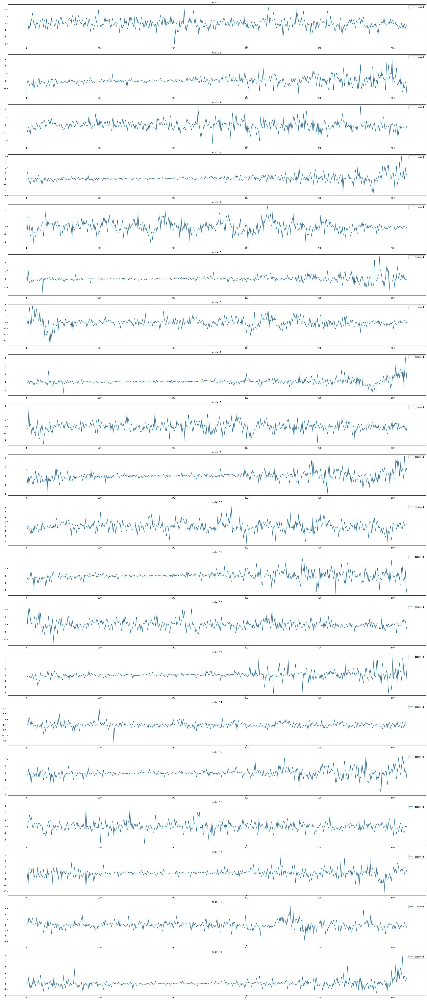

In [257]:
fig,ax = plt.subplots(20,1,figsize=(30,70))
for k in range(20):
    ax[k].plot(np.array(loader1.targets).reshape(20,-1)[k][:],alpha=1,label='observed')
    ax[k].set_title('node: {}'.format(node_list[k]))
    ax[k].legend()
fig.tight_layout()


In [258]:
# fig,ax = plt.subplots(3,1,figsize=(20,10))
# for k in range(3):
#     ax[k].plot(np.array(loader1.targets).reshape(20,-1)[k][:],alpha=1,label='observed')
#     ax[k].set_title('node: {}'.format(node_list[k]))
#     ax[k].legend()
# fig.tight_layout()
# plt.savefig('graph_node_ex2.png')

In [463]:
x = list(range(a.snapshot_count))
y1 = np.array(a.features)[:, 0, :].reshape(-1)
y2 = np.array(a.features)[:, 1, :].reshape(-1)
y3 = np.array(a.features)[:, 2, :].reshape(-1)
y4 = np.array(a.features)[:, 3, :].reshape(-1)
y5 = np.array(a.features)[:, 4, :].reshape(-1)
y6 = np.array(a.features)[:, 5, :].reshape(-1)

_df = pd.DataFrame({'x': x, 'y1': y1, 'y2': y2, 'y3': y3, 'y4': y4, 'y5': y5, 'y6':y6})

In [464]:
# fig = px.line(_df, x='x', y=['y1', 'y2','y3','y4','y5','y6'])
# fig.update_layout(width=900, height=500)
# fig.show()

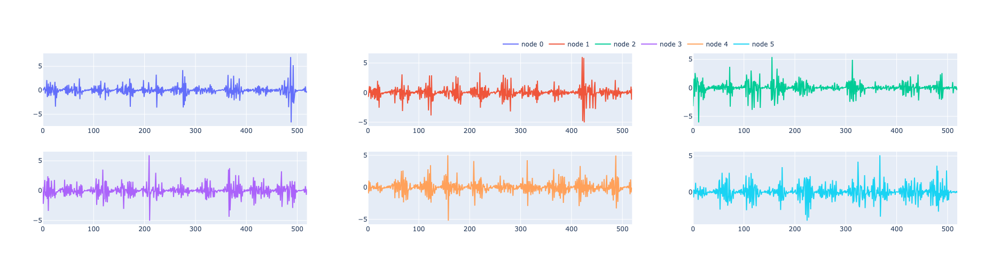

In [465]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# 서브플롯 생성
fig = make_subplots(rows=2, cols=3)

# 각 서브플롯에 선 그래프 추가
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y1'], mode='lines', name='node 0'), row=1, col=1)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y2'], mode='lines', name='node 1'), row=1, col=2)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y3'], mode='lines', name='node 2'), row=1, col=3)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y4'], mode='lines', name='node 3'), row=2, col=1)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y5'], mode='lines', name='node 4'), row=2, col=2)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y6'], mode='lines', name='node 5'), row=2, col=3)

# 그래프 크기 조정
fig.update_layout(width=1000, height=500, legend=dict(x=0.5, y=1.1, orientation='h'))

# 그래프 출력
fig.show()


In [466]:
with open('fig_chickenpox.pkl', 'wb') as file:
    pickle.dump(fig, file)

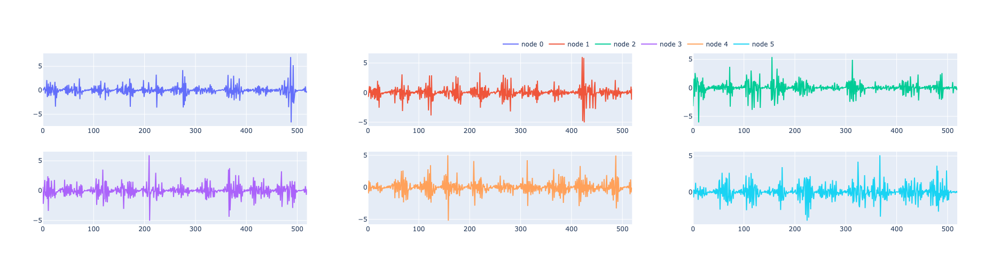

In [467]:
with open("fig_chickenpox.pkl", "rb") as file:
    loaded_object1 = pickle.load(file)

loaded_object1

## PedalMeDatasetLoader

Pedal Me Deliveries

- A dataset of PedalMe Bicycle deliver orders in London between 2020 and 2021. We made it public during the development of PyTorch Geometric Temporal. The underlying graph is static - vertices are localities and edges are spatial_connections. Vertex features are lagged weekly counts of the delivery demands (we included 4 lags). The target is the weekly number of deliveries the upcoming week. Our dataset consist of more than 30 snapshots (weeks)
- 2020년과 2021년 사이 런던에서 PedalMe 자전거 배송 주문 데이터셋
- 그래프는 정적
- node 장소
- edge 공간 연결
- node 특성은 배송 수요의 지연된 주간 횟수(4주의 지연이 포함되어 있음)
- target 다음 주에 대한 주간 배송 횟수
- 30개 이상의 스냅샷(주간)

데이터정리 

- T = 31
- V = 지역의 집합
- N = 15 # number of nodes 
- E = 225 # edges 
- $f(v,t)$의 차원? (1,) #  number of deliveries
- 시간에 따라서 N이 변하는지? False
- 시간에 따라서 E가 변하는지? False
- X: (15,4) (N,4), $f(v,t_0),f(v,t_1),f(v,t_2),f(v,t_3)$
- y: (15,) (N,), $f(v,t_4)$
- 예제코드적용가능여부: Yes

`-` Nodes : `15`

- vertices are localities

`-`Edges : `225`

- edges are spatial_connections

`-` Time : `31`

- between 2020 and 2021
- per weeks

In [625]:
from torch_geometric_temporal.dataset import PedalMeDatasetLoader
loader2 = PedalMeDatasetLoader()

In [626]:
a = loader2.get_dataset(lags=1)

In [627]:
np.array(a.features).shape

(34, 15, 1)

In [628]:
np.array(a.edge_index).shape

(2, 225)

In [629]:
np.array(a.edge_weight).shape

(225,)

In [630]:
G = nx.Graph()

In [631]:
G.add_edges_from(a.edge_index.T)

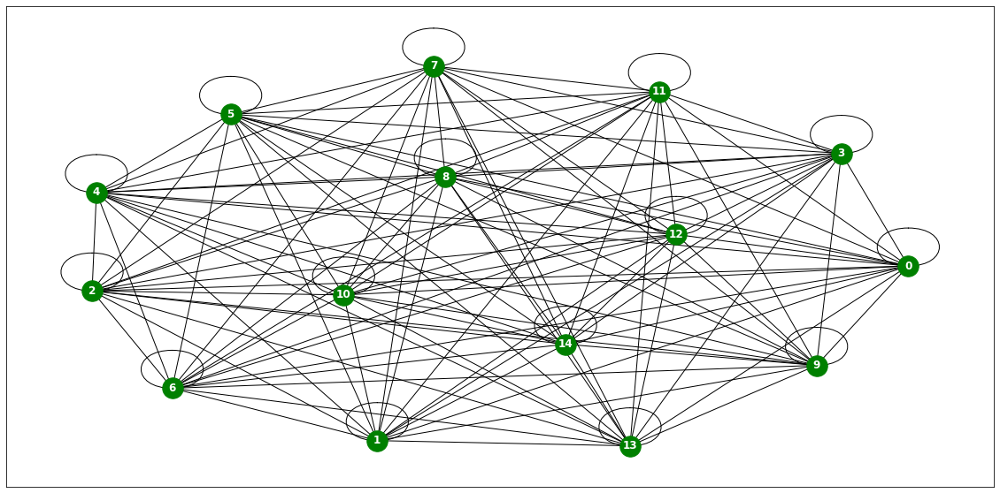

In [635]:
plt.figure(figsize=(20, 10)) 
nx.draw_networkx(G, with_labels=True, font_weight='bold', node_color='green', node_size=550, font_color='white', width=1)
plt.savefig("graph_node_pedalme.png")

In [577]:
node_list = []
for i in range(0, 15):
    node_list.append(i)

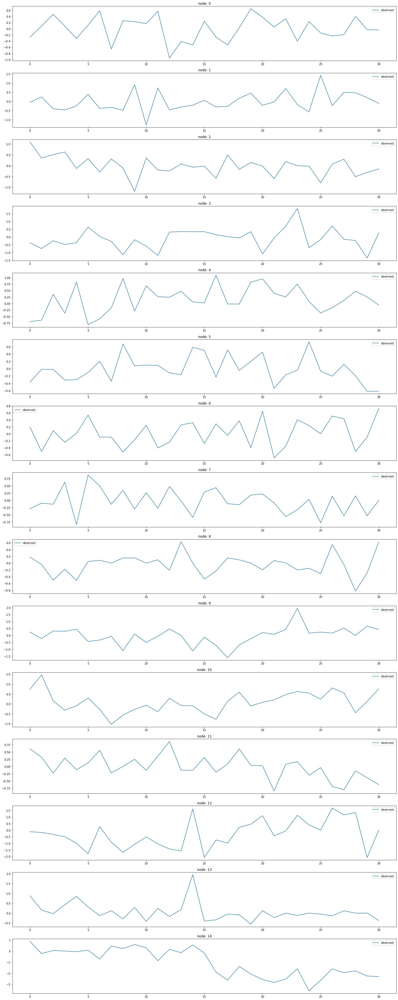

In [719]:
fig,ax = plt.subplots(15,1,figsize=(20,50))
for k in range(15):
    ax[k].plot(np.array(loader2.targets).reshape(15,-1)[k][:],label='observed')
    ax[k].set_title('node: {}'.format(node_list[k]))
    ax[k].legend()
fig.tight_layout()


In [431]:
x = list(range(a.snapshot_count))
y1 = np.array(a.features)[:, 0, :].reshape(-1)
y2 = np.array(a.features)[:, 1, :].reshape(-1)
y3 = np.array(a.features)[:, 2, :].reshape(-1)
y4 = np.array(a.features)[:, 3, :].reshape(-1)
y5 = np.array(a.features)[:, 4, :].reshape(-1)
y6 = np.array(a.features)[:, 5, :].reshape(-1)

_df = pd.DataFrame({'x': x, 'y1': y1, 'y2': y2, 'y3': y3, 'y4': y4, 'y5': y5, 'y6':y6})

In [432]:
# fig = px.line(_df, x='x', y=['y1', 'y2','y3','y4','y5','y6'])
# fig.update_layout(width=900, height=500)
# fig.show()

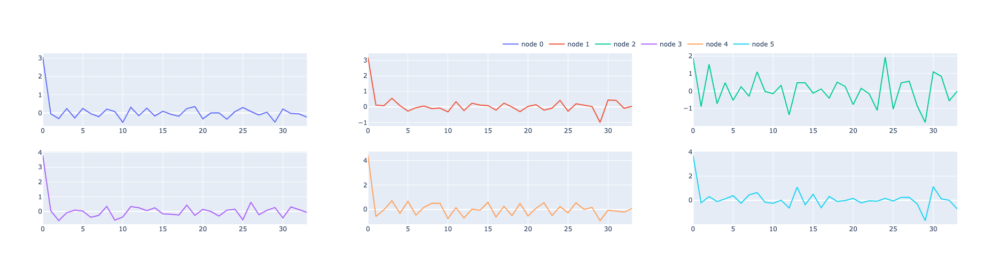

In [433]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# 서브플롯 생성
fig = make_subplots(rows=2, cols=3)

# 각 서브플롯에 선 그래프 추가
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y1'], mode='lines', name='node 0'), row=1, col=1)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y2'], mode='lines', name='node 1'), row=1, col=2)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y3'], mode='lines', name='node 2'), row=1, col=3)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y4'], mode='lines', name='node 3'), row=2, col=1)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y5'], mode='lines', name='node 4'), row=2, col=2)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y6'], mode='lines', name='node 5'), row=2, col=3)

# 그래프 크기 조정
fig.update_layout(width=1000, height=500, legend=dict(x=0.5, y=1.1, orientation='h'))

# 그래프 출력
fig.show()


In [434]:
with open('fig_pedalme.pkl', 'wb') as file:
    pickle.dump(fig, file)

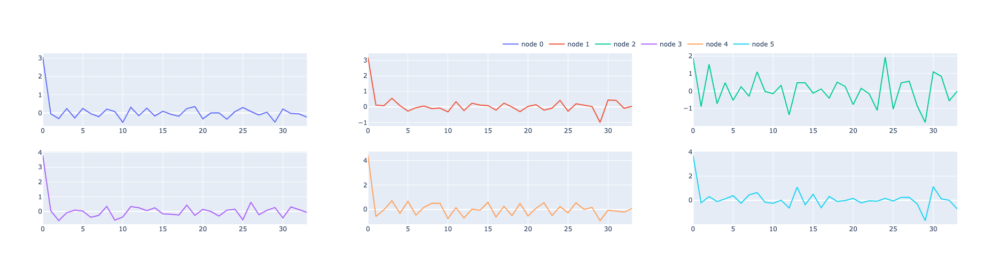

In [435]:
with open("fig_pedalme.pkl", "rb") as file:
    loaded_object1 = pickle.load(file)

loaded_object1

## WikiMathsDatasetLoader

Wikipedia Math

- A dataset of vital mathematics articles from Wikipedia. We made it public during the development of PyTorch Geometric Temporal. The underlying graph is static - vertices are Wikipedia pages and edges are links between them. The graph is directed and weighted. Weights represent the number of links found at the source Wikipedia page linking to the target Wikipedia page. The target is the daily user visits to the Wikipedia pages between March 16th 2019 and March 15th 2021 which results in 731 periods.
- 위키피디아에서 중요한 수학 기사들로 이루어진 데이터셋
- 그래프는 정적
- node 위키피디아 페이지
- edge 페이지 간의 링크
- 그래프는 방향성이 있으며 가중치가 있음
- 가중치는 소스 위키피디아 페이지에서 대상 위키피디아 페이지로 연결된 링크 수
- target 2019년 3월 16일부터 2021년 3월 15일까지 위키피디아 페이지의 일일 사용자 방문 수
- 기간은 731개의 기간으로 구성됩니다.

데이터정리 

- T = 723
- V = 위키피디아 페이지
- N = 1068 # number of nodes 
- E = 27079 # edges 
- $f(v,t)$의 차원? (1,) # 해당페이지를 유저가 방문한 횟수 
- 시간에 따라서 N이 변하는지? False
- 시간에 따라서 E가 변하는지? False
- X: (1068,8) (N,8), $f(v,t_0),f(v,t_1),f(v,t_2),f(v,t_3),f(v,t_4),f(v,t_5),f(v,t_6),f(v,t_7)$
- y: (1068,) (N,), $f(v,t_8)$
- 예제코드적용가능여부: Yes

`-` Nodes : `1068`

- vertices are Wikipedia pages

`-`Edges : `27079`

- edges are links between them

`-` Time : `723`

- Wikipedia pages between March 16th 2019 and March 15th 2021
- per weeks

In [583]:
from torch_geometric_temporal.dataset import WikiMathsDatasetLoader
loader3 = WikiMathsDatasetLoader()

In [584]:
a = loader3.get_dataset(lags=1)

In [585]:
np.array(a.features).shape

(730, 1068, 1)

In [586]:
np.array(a.edge_index).shape

(2, 27079)

In [587]:
np.array(a.edge_weight).shape

(27079,)

In [588]:
G = nx.Graph()

In [589]:
G.add_edges_from(a.edge_index.T)

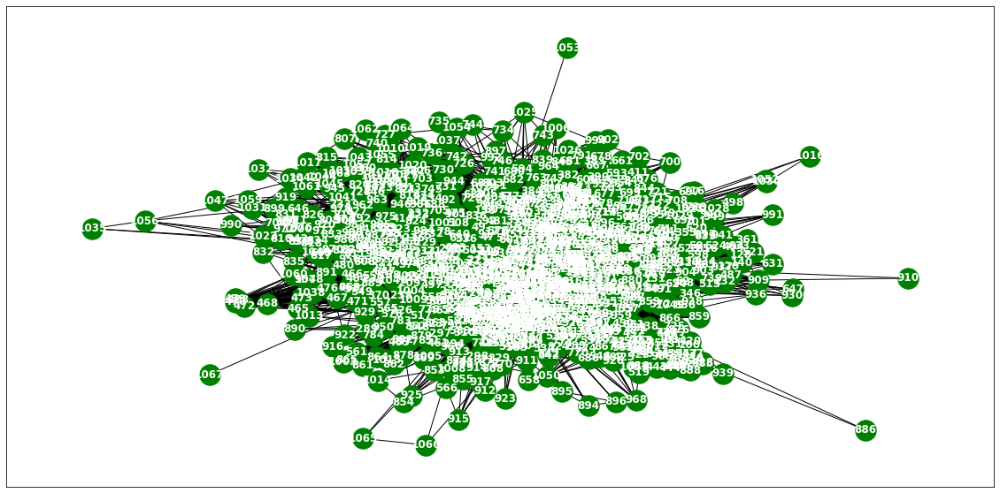

In [590]:
plt.figure(figsize=(20, 10)) 
nx.draw_networkx(G, with_labels=True, font_weight='bold', node_color='green', node_size=550, font_color='white', width=1)
plt.savefig("graph_node_wikimath.png")

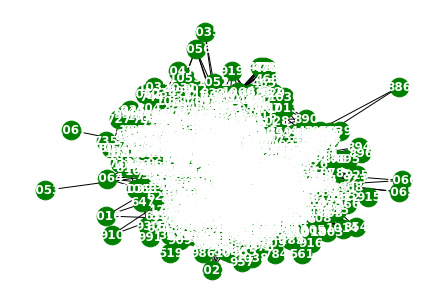

In [1021]:
nx.draw(G,with_labels=True,font_weight='bold',node_color='green',node_size=350,font_color='white',width=1)

In [1022]:
node_list = []
for i in range(0, 1068):
    node_list.append(i)

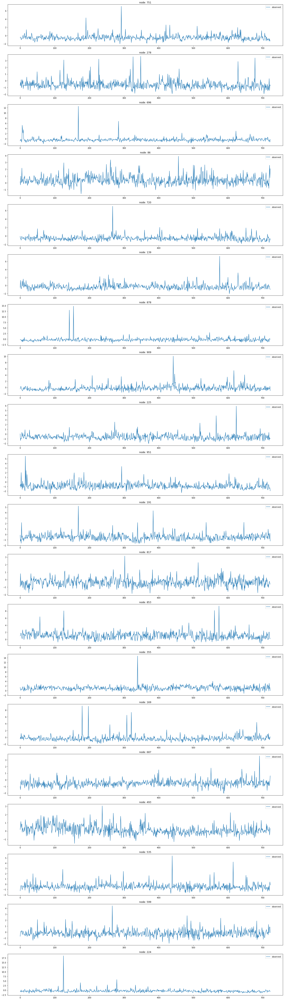

In [1026]:
fig, ax = plt.subplots(20, 1, figsize=(20, 70))
indices = random.sample(range(0, 1068), 20)
for k, idx in enumerate(indices):
    ax[k].plot(np.array(loader3.targets).reshape(1068,-1)[idx][:], label='observed')
    ax[k].set_title('node: {}'.format(node_list[idx]))
    ax[k].legend()
fig.tight_layout()

In [482]:
x = list(range(a.snapshot_count))
y1 = np.array(a.features)[:, 0, :].reshape(-1)
y2 = np.array(a.features)[:, 1, :].reshape(-1)
y3 = np.array(a.features)[:, 2, :].reshape(-1)
y4 = np.array(a.features)[:, 3, :].reshape(-1)
y5 = np.array(a.features)[:, 4, :].reshape(-1)
y6 = np.array(a.features)[:, 5, :].reshape(-1)

_df = pd.DataFrame({'x': x, 'y1': y1, 'y2': y2, 'y3': y3, 'y4': y4, 'y5': y5, 'y6':y6})

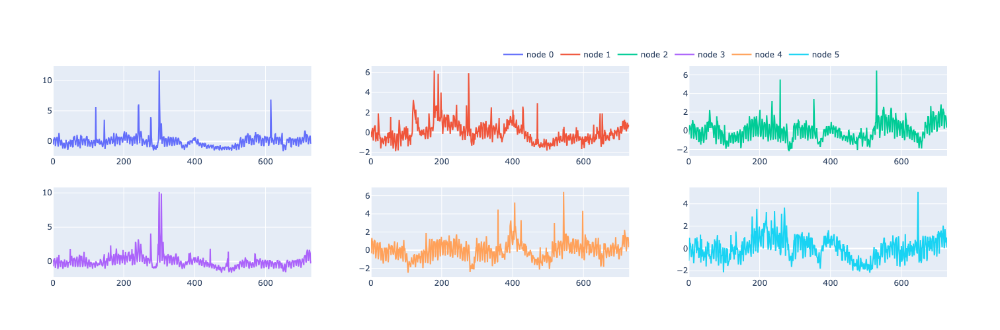

In [483]:
fig = make_subplots(rows=2, cols=3)

# 각 서브플롯에 선 그래프 추가
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y1'], mode='lines', name='node 0'), row=1, col=1)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y2'], mode='lines', name='node 1'), row=1, col=2)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y3'], mode='lines', name='node 2'), row=1, col=3)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y4'], mode='lines', name='node 3'), row=2, col=1)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y5'], mode='lines', name='node 4'), row=2, col=2)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y6'], mode='lines', name='node 5'), row=2, col=3)

# 그래프 크기 조정
fig.update_layout(width=1000, height=500, legend=dict(x=0.5, y=1.1, orientation='h'))

# 그래프 출력
fig.show()

In [484]:
with open('fig_wikimath.pkl', 'wb') as file:
    pickle.dump(fig, file)

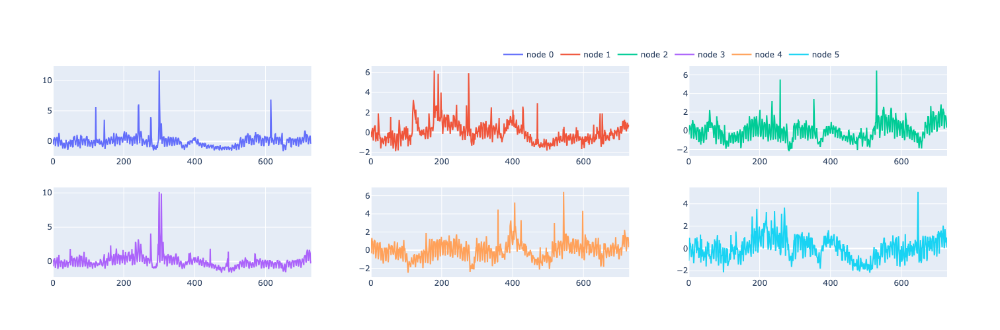

In [485]:
with open("fig_wikimath.pkl", "rb") as file:
    loaded_object1 = pickle.load(file)

loaded_object1

## WindmillOutputLargeDatasetLoader

- Hourly energy output of windmills from a European country for more than 2 years. Vertices represent 319 windmills and weighted edges describe the strength of relationships. The target variable allows for regression tasks
- 유럽 국가의 풍력 발전소에서 2년 이상에 걸쳐 발생한 시간별 에너지 출력 데이터
- node 319개의 풍력 발전소
- 가중치가 있는 edge는 관계의 강도
- 회귀 분석 작업에 적합한 목표 변수를 제공

데이터정리 

- T = 17464
- V = 풍력발전소
- N = 319 # number of nodes 
- E = 101761 = N^2 # edges 
- $f(v,t)$의 차원? (1,) # Hourly energy output 
- 시간에 따라서 N이 변하는지? False
- 시간에 따라서 E가 변하는지? False
- X: (319,4) (N,4), $f(v,t_0),f(v,t_1),f(v,t_2),f(v,t_3)$
- y: (319,) (N,), $f(v,t_4)$
- 예제코드적용가능여부: Yes

`-` Nodes : `319`

- vertices represent 319 windmills

`-`Edges : `101761`

- weighted edges describe the strength of relationships.

`-` Time : `17464`

- more than 2 years

In [961]:
from torch_geometric_temporal.dataset import WindmillOutputLargeDatasetLoader
loader4 = WindmillOutputLargeDatasetLoader()

In [962]:
a = loader4.get_dataset()

In [963]:
np.array(a.features).shape

(17464, 319, 8)

In [964]:
np.array(a.edge_index).shape

(2, 101761)

In [965]:
np.array(a.edge_weight).shape

(101761,)

In [966]:
G = nx.Graph()

In [967]:
G.add_edges_from(a.edge_index.T)

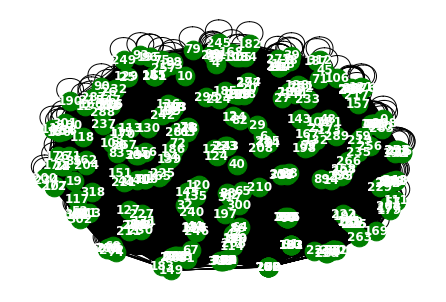

In [968]:
nx.draw(G,with_labels=True,font_weight='bold',node_color='green',node_size=350,font_color='white',width=1)

In [990]:
a= np.arange(1,100)
a

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
       52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68,
       69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85,
       86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99])

In [991]:
a[::10]

array([ 1, 11, 21, 31, 41, 51, 61, 71, 81, 91])

In [997]:
np.array(loader4.targets).reshape(319,-1)[idx][::100].shape

(175,)

In [969]:
node_list = []
for i in range(0, 319):
    node_list.append(i)

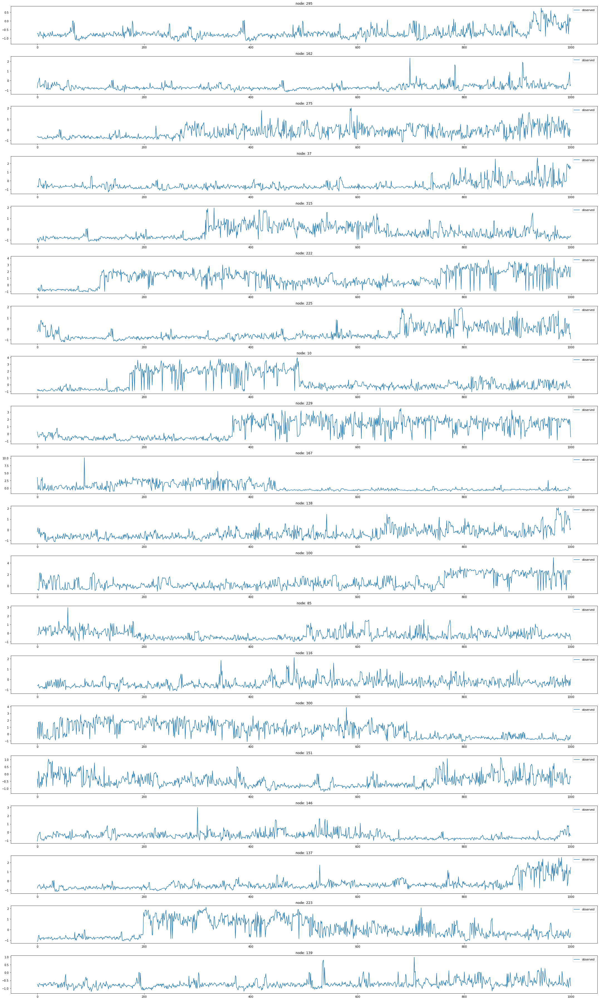

In [1006]:
fig, ax = plt.subplots(20, 1, figsize=(30, 50))
indices = random.sample(range(0, 319), 20)
for k, idx in enumerate(indices):
    ax[k].plot(np.array(loader4.targets).reshape(319,-1)[idx][:1000], label='observed')
    ax[k].set_title('node: {}'.format(node_list[idx]))
    ax[k].legend()
fig.tight_layout()

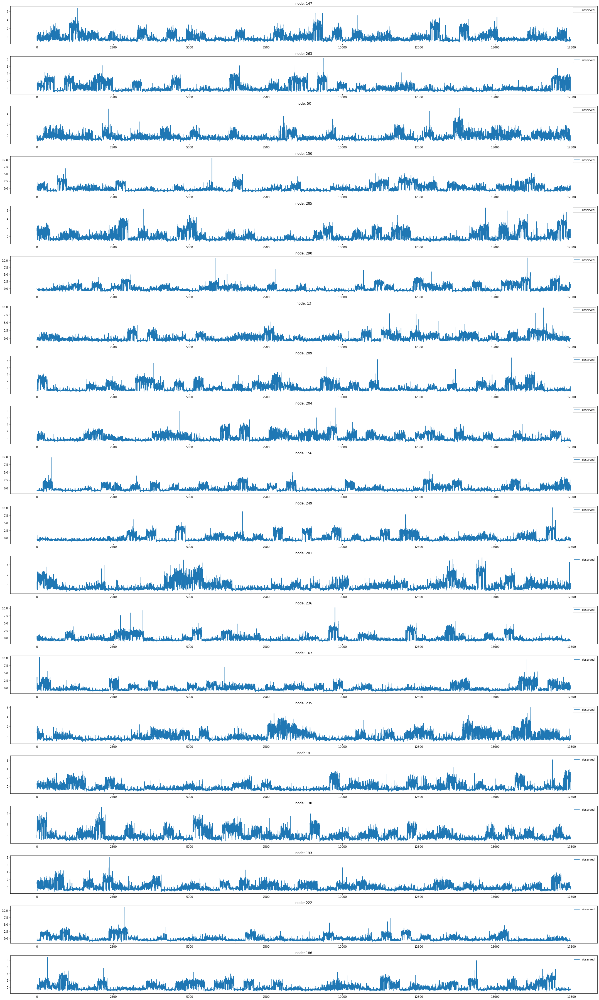

In [783]:
fig, ax = plt.subplots(20, 1, figsize=(30, 50))
indices = random.sample(range(0, 319), 20)
for k, idx in enumerate(indices):
    ax[k].plot(np.array(loader4.targets).reshape(319,-1)[idx][:], label='observed')
    ax[k].set_title('node: {}'.format(node_list[idx]))
    ax[k].legend()
fig.tight_layout()

## WindmillOutputMediumDatasetLoader

- Hourly energy output of windmills from a European country for more than 2 years. Vertices represent 26 windmills and weighted edges describe the strength of relationships. The target variable allows for regression tasks.
- 유럽 국가의 풍력 발전소에서 2년 이상에 걸쳐 발생한 시간별 에너지 출력 데이터셋
- node 26개의 풍력 발전소
- 가중치가 있는 edge는 관계의 강도
- 회귀 분석 작업에 적합한 목표 변수를 제공

데이터정리 

- T = 17464
- V = 풍력발전소
- N = 26 # number of nodes 
- E = 676 = N^2 # edges 
- $f(v,t)$의 차원? (1,) # Hourly energy output 
- 시간에 따라서 N이 변하는지? False
- 시간에 따라서 E가 변하는지? False
- X: (26,4) (N,8), $f(v,t_0),f(v,t_1),f(v,t_2),f(v,t_3)$
- y: (26,) (N,), $f(v,t_4)$
- 예제코드적용가능여부: Yes

`-` Nodes : `26`

- vertices represent 26 windmills

`-`Edges : `676`

- weighted edges describe the strength of relationships

`-` Time : `17464`

-  more than 2 years

In [10]:
from torch_geometric_temporal.dataset import WindmillOutputMediumDatasetLoader
loader5 = WindmillOutputMediumDatasetLoader()

In [11]:
a = loader5.get_dataset()

In [12]:
np.array(a.features).shape

(17464, 26, 8)

In [13]:
np.array(a.edge_index).shape

(2, 676)

In [14]:
np.array(a.edge_weight).shape

(676,)

In [15]:
G = nx.Graph()

In [16]:
G.add_edges_from(a.edge_index.T)

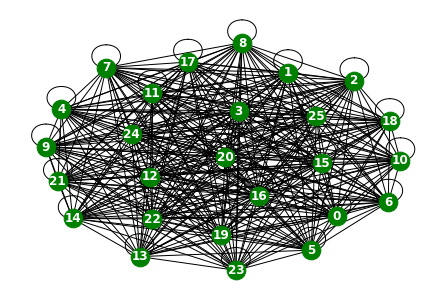

In [17]:
nx.draw(G,with_labels=True,font_weight='bold',node_color='green',node_size=350,font_color='white',width=1)

In [18]:
node_list = []
for i in range(0, 26):
    node_list.append(i)

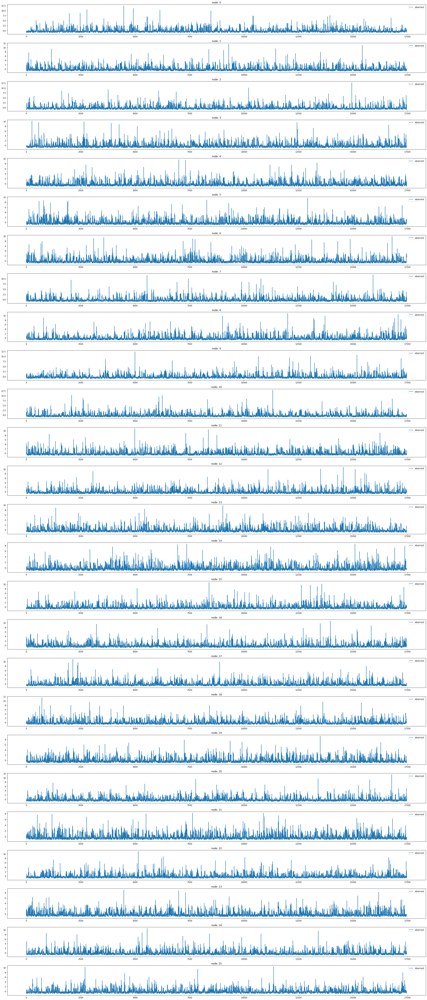

In [19]:
fig,ax = plt.subplots(26,1,figsize=(30,70))
for k in range(26):
    ax[k].plot(np.array(loader5.targets).reshape(26,-1)[k],label='observed')
    ax[k].set_title('node: {}'.format(node_list[k]))
    ax[k].legend()
fig.tight_layout()


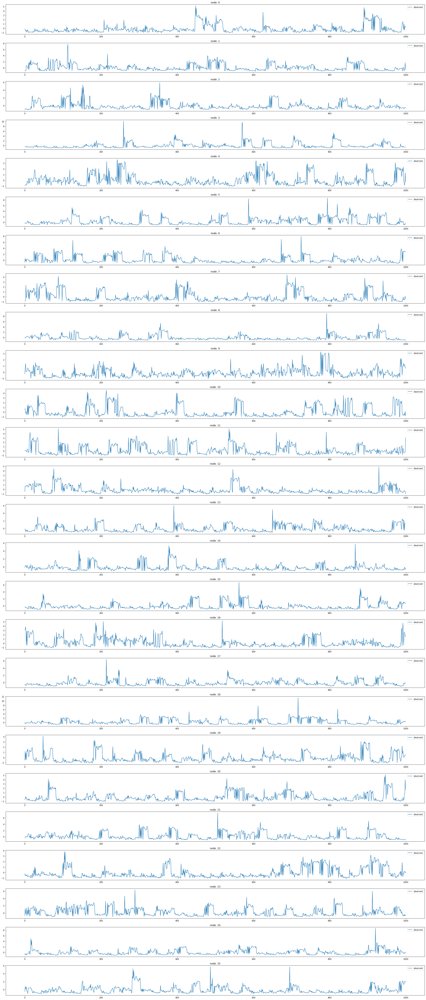

In [1013]:
fig,ax = plt.subplots(26,1,figsize=(30,70))
for k in range(26):
    ax[k].plot(np.array(loader5.targets).reshape(26,-1)[k][:1000],label='observed')
    ax[k].set_title('node: {}'.format(node_list[k]))
    ax[k].legend()
fig.tight_layout()


## WindmillOutputSmallDatasetLoader

- Hourly energy output of windmills from a European country for more than 2 years. Vertices represent 11 windmills and weighted edges describe the strength of relationships. The target variable allows for regression tasks.
- 유럽 국가의 풍력 발전소에서 2년 이상에 걸쳐 발생한 시간별 에너지 출력 데이터셋
- node 11개의 풍력 발전소
- 가중치가 있는 edge는 관계의 강도
- 회귀 분석 작업에 적합한 목표 변수를 제공합니다.

데이터정리 

- T = 17464
- V = 풍력발전소
- N = 11 # number of nodes 
- E = 121 = N^2 # edges 
- $f(v,t)$의 차원? (1,) # Hourly energy output 
- 시간에 따라서 N이 변하는지? False
- 시간에 따라서 E가 변하는지? False
- X: (11,4) (N,4), $f(v,t_0),f(v,t_1),f(v,t_2),f(v,t_3)$
- y: (11,) (N,), $f(v,t_4)$
- 예제코드적용가능여부: Yes

`-` Nodes : `11`

- vertices represent 11 windmills

`-`Edges : `121`

- weighted edges describe the strength of relationships

`-` Time : `17464`

- more than 2 years

In [591]:
from torch_geometric_temporal.dataset import WindmillOutputSmallDatasetLoader
loader6 = WindmillOutputSmallDatasetLoader()

In [592]:
a = loader6.get_dataset(lags=1)

In [593]:
np.array(a.features).shape

(17471, 11, 1)

In [594]:
np.array(a.edge_index).shape

(2, 121)

In [595]:
np.array(a.edge_weight).shape

(121,)

In [596]:
G = nx.Graph()

In [597]:
G.add_edges_from(a.edge_index.T)

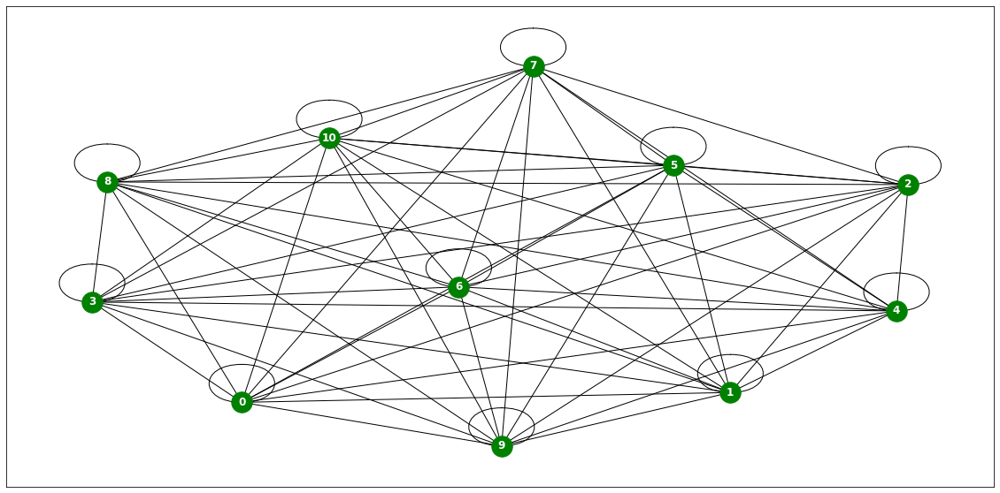

In [598]:
plt.figure(figsize=(20, 10)) 
nx.draw_networkx(G, with_labels=True, font_weight='bold', node_color='green', node_size=550, font_color='white', width=1)
plt.savefig("graph_node_windmillsmall.png")

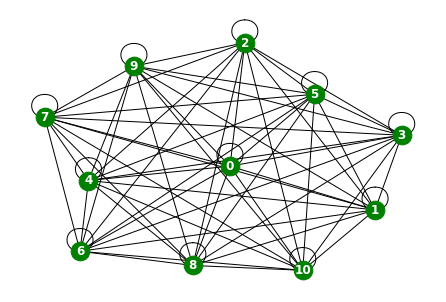

In [883]:
nx.draw(G,with_labels=True,font_weight='bold',node_color='green',node_size=350,font_color='white',width=1)

In [807]:
node_list = []
for i in range(0, 11):
    node_list.append(i)

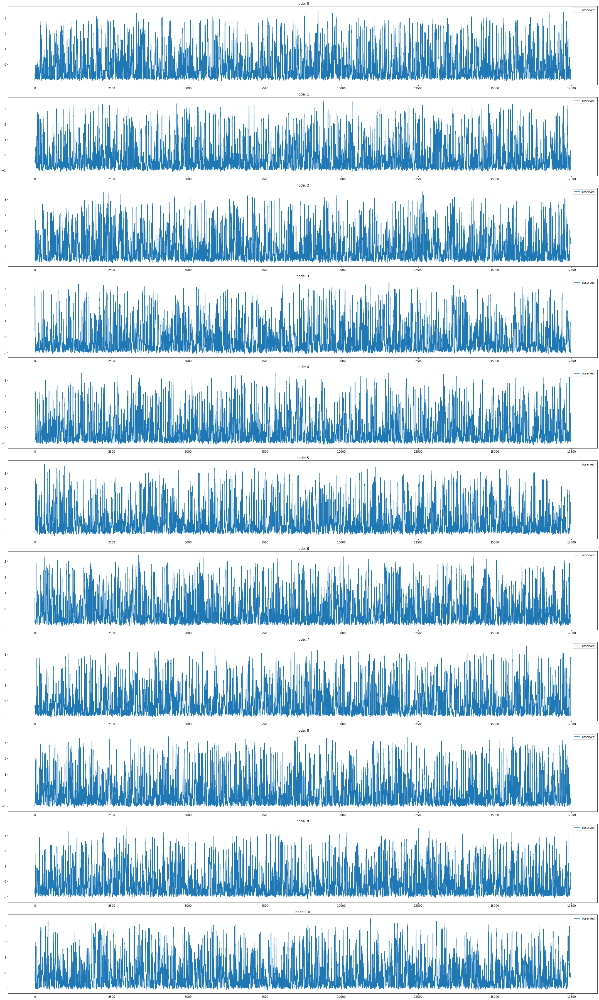

In [809]:
fig,ax = plt.subplots(11,1,figsize=(30,50))
for k in range(11):
    ax[k].plot(np.array(loader6.targets).reshape(11,-1)[k][:],label='observed')
    ax[k].set_title('node: {}'.format(node_list[k]))
    ax[k].legend()
fig.tight_layout()


In [441]:
x = list(range(a.snapshot_count))
y1 = np.array(a.features)[:, 0, :].reshape(-1)
y2 = np.array(a.features)[:, 1, :].reshape(-1)
y3 = np.array(a.features)[:, 2, :].reshape(-1)
y4 = np.array(a.features)[:, 3, :].reshape(-1)
y5 = np.array(a.features)[:, 4, :].reshape(-1)
y6 = np.array(a.features)[:, 5, :].reshape(-1)

_df = pd.DataFrame({'x': x, 'y1': y1, 'y2': y2, 'y3': y3, 'y4': y4, 'y5': y5, 'y6':y6})

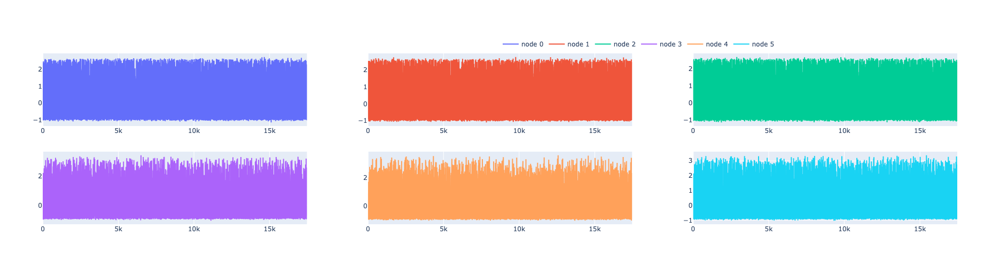

In [442]:
fig = make_subplots(rows=2, cols=3)

# 각 서브플롯에 선 그래프 추가
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y1'], mode='lines', name='node 0'), row=1, col=1)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y2'], mode='lines', name='node 1'), row=1, col=2)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y3'], mode='lines', name='node 2'), row=1, col=3)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y4'], mode='lines', name='node 3'), row=2, col=1)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y5'], mode='lines', name='node 4'), row=2, col=2)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y6'], mode='lines', name='node 5'), row=2, col=3)

# 그래프 크기 조정
fig.update_layout(width=1000, height=500, legend=dict(x=0.5, y=1.1, orientation='h'))

# 그래프 출력
fig.show()

In [443]:
with open('fig_windmillsmall.pkl', 'wb') as file:
    pickle.dump(fig, file)

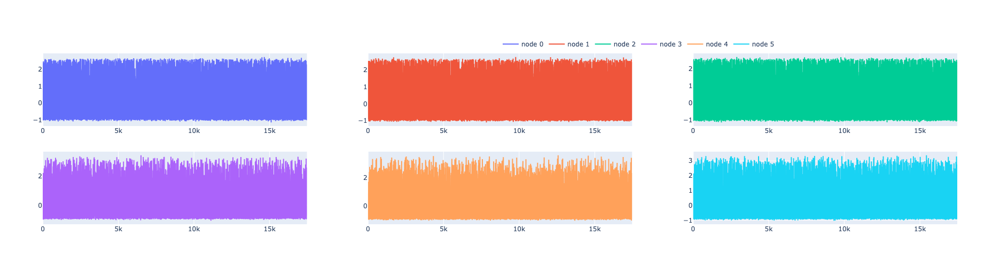

In [444]:
with open("fig_windmillsmall.pkl", "rb") as file:
    loaded_object1 = pickle.load(file)

loaded_object1

----

# Windmill 비교

차이점

1. 관측소 수 차이

- 하지만 어떤 노드가 겹치는지 알 수 없음

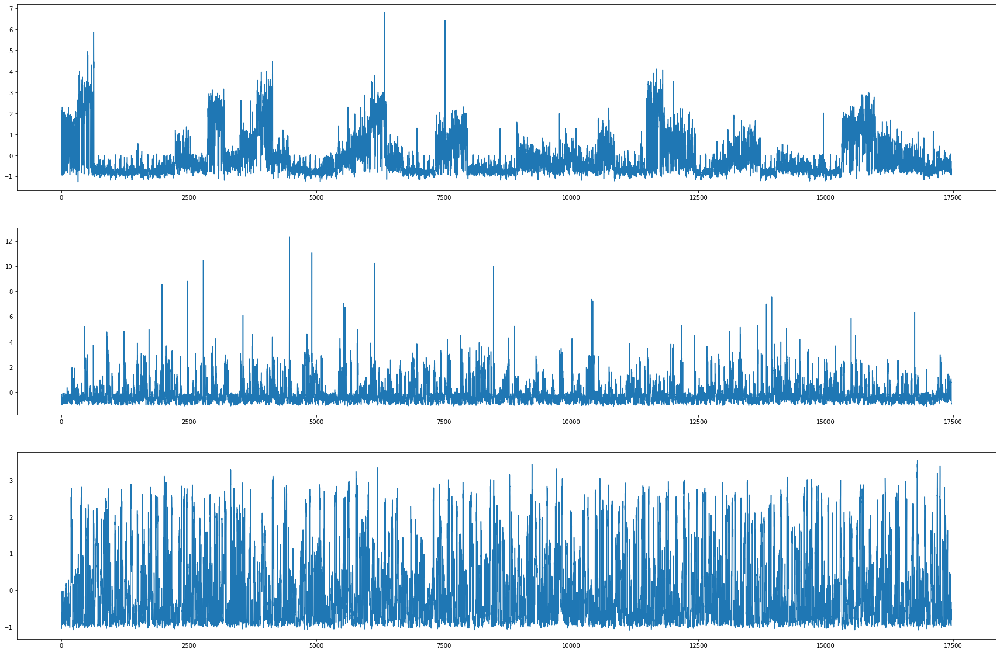

In [844]:
fig,ax = plt.subplots(3, 1, figsize=(30, 20))
ax[0].plot(np.array(loader4.targets).reshape(319,-1)[0][:],label='observed') # laarge
ax[1].plot(np.array(loader5.targets).reshape(26,-1)[0][:],label='observed') # medium
ax[2].plot(np.array(loader6.targets).reshape(11,-1)[0][:],label='observed') # small

----

## METRLADatasetLoader_real world traffic dataset

A traffic forecasting dataset based on Los Angeles Metropolitan traffic conditions. The dataset contains traffic readings collected from 207 loop detectors on highways in Los Angeles County in aggregated 5 minute intervals for 4 months between March 2012 to June 2012.

데이터정리 

- T = 33
- V = 구역
- N = 207 # number of nodes 
- E = 225 
- $f(v,t)$의 차원? (3,) # Hourly energy output 
- 시간에 따라서 N이 변하는지? False
- 시간에 따라서 E가 변하는지? False
- X: (207,4) (N,2,12), $x_0,x_1,x_2,x_3,x_4,x_5,x_6,x_7,x_8,x_9,x_{10},x_{11},z_0,z_1,z_2,z_3,z_4,z_5,z_6,z_7,z_8,z_9,z_{10},z_{11}$
- y: (207,) (N,), $(x_{12})$
- 예제코드적용가능여부: No

https://arxiv.org/pdf/1707.01926.pdf

`-` Nodes : `207`

- vertices are localities

`-`Edges : `225`

- edges are spatial_connections

`-` Time : `33`

- between 2020 and 2021
- per weeks

In [2]:
from torch_geometric_temporal.dataset import METRLADatasetLoader
loader7 = METRLADatasetLoader()

In [166]:
a = loader7.get_dataset(num_timesteps_in=1,num_timesteps_out=1)

In [167]:
np.array(a.edge_index).shape

(2, 1722)

In [168]:
np.array(a.edge_weight).shape

(1722,)

In [169]:
np.array(a.targets).shape

(34271, 207, 1)

In [930]:
G = nx.Graph()

In [931]:
G.add_edges_from(a.edge_index.T)

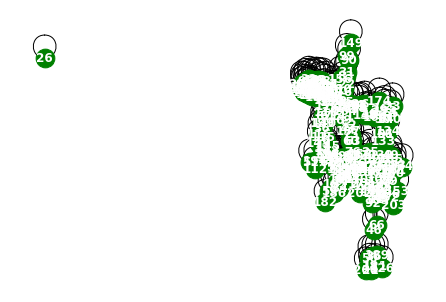

In [932]:
nx.draw(G,with_labels=True,font_weight='bold',node_color='green',node_size=350,font_color='white',width=1)

In [172]:
node_list = []
for i in range(0, 207):
    node_list.append(i)

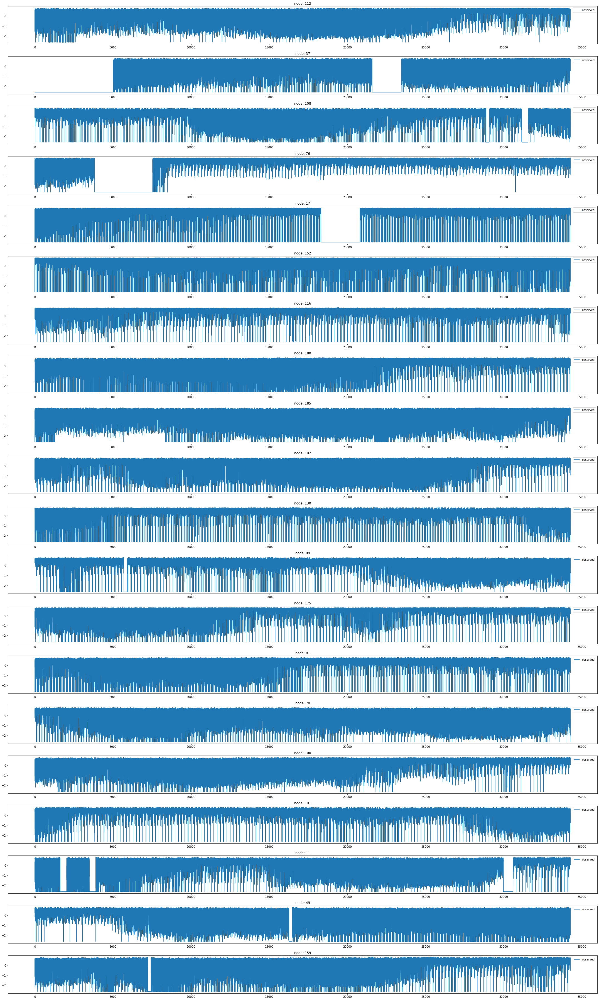

In [173]:
fig, ax = plt.subplots(20, 1, figsize=(30, 50))
indices = random.sample(range(0, 207), 20)
for k, idx in enumerate(indices):
    ax[k].plot(np.array(loader7.targets).reshape(207,-1)[idx], label='observed')
    ax[k].set_title('node: {}'.format(node_list[idx]))
    ax[k].legend()
fig.tight_layout()

## PemsBayDatasetLoader

https://onlinelibrary.wiley.com/doi/pdf/10.1111/tgis.12644

- A traffic forecasting dataset as described in Diffusion Convolution Layer Paper.
- A traffic forecasting dataset as described in Diffusion Convolution Layer Paper.
- This traffic dataset is collected by California Transportation Agencies (CalTrans) Performance Measurement System (PeMS). It is represented by a network of 325 traffic sensors in the Bay Area with 6 months of traffic readings ranging from Jan 1st 2017 to May 31th 2017 in 5 minute intervals.
- For details see: `"Diffusion Convolutional Recurrent Neural Network: Data-Driven Traffic Forecasting" <https://arxiv.org/abs/1707.01926>`

- 캘리포니아 교통국(CalTrans) 성능 측정 시스템(PeMS)에서 수집
- 2017년 1월 1일부터 2017년 5월 31일까지 6개월 동안 5분 간격으로 트래픽 판독치가 포함된 베이 지역의 325개 교통 센서 네트워크로 표시

데이터정리 

- T = 17470
- V = 교통센서
- N = 325 # number of nodes 
- E = 2694 = N^2 # edges 
- $f(v,t)$의 차원? (1,) # Hourly energy output 
- 시간에 따라서 N이 변하는지? False
- 시간에 따라서 E가 변하는지? No
- X: (325,2,12) (N,2,12), 
    - $x_0,x_1,x_2,x_3,x_4,x_5,x_6,x_7,x_8,x_9,x_{10},x_{11}$ 
    - $z_0,z_1,z_2,z_3,z_4,z_5,z_6,z_7,z_8,z_9,z_{10},z_{11}$
- y: (325,) (N,2,12), 
    - $x_{13},x_{14},x_{15},x_{16},x_{17},x_{18},x_{19},x_{20},x_{21},x_{22},x_{23},x_{24}$
    - $z_{13},z_{14},z_{15},z_{16},z_{17},z_{18},z_{19},z_{20},z_{21},z_{22},z_{23},z_{24}$
- 예제코드적용가능여부: No

`-` Nodes : `325`

- vertices are sensors

`-`Edges : `2694`

- weighted edges are between seonsor paris measured by the road nretwork distance

`-` Time : `52081`

- 6 months of traffic readings ranging from Jan 1st 2017 to May 31th 2017 in 5 minute intervals

In [1]:
from torch_geometric_temporal.dataset import PemsBayDatasetLoader
loader8 = PemsBayDatasetLoader()

In [291]:
a = loader8.get_dataset(num_timesteps_in=1,num_timesteps_out=1)

In [292]:
np.array(a.edge_index).shape

(2, 2694)

In [293]:
a.edge_index

array([[  0,   1,   2, ..., 324, 324, 324],
       [  0,   1,   2, ..., 257, 310, 324]])

In [288]:
np.array(a.edge_weight).shape

(2694,)

In [206]:
np.array(a.targets).shape

(52104, 325, 2, 1)

In [208]:
a.targets[0][0][0]

array([0.99281436], dtype=float32)

In [209]:
node_list = []
for i in range(0, 325):
    node_list.append(i)

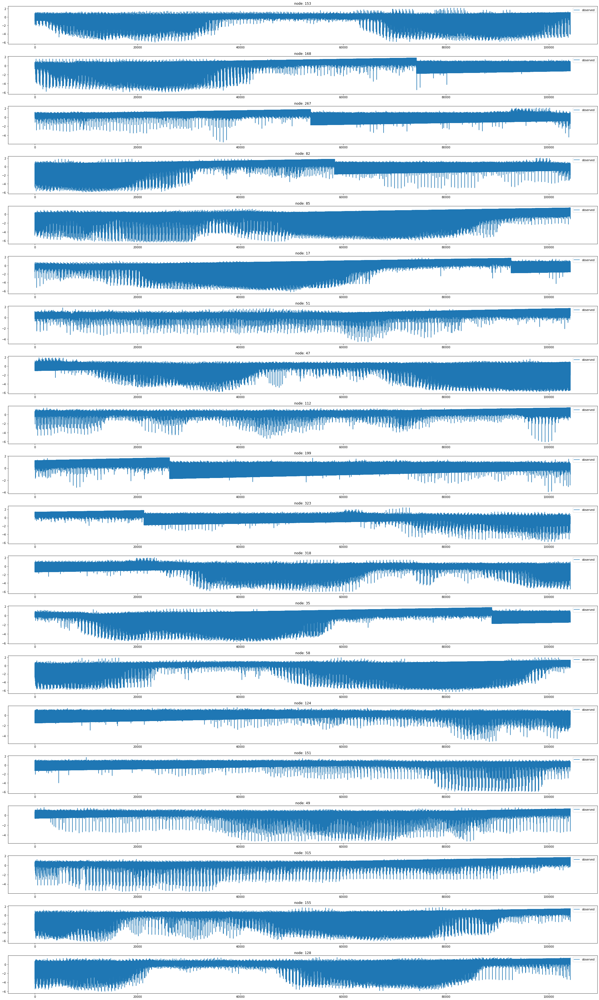

In [210]:
fig, ax = plt.subplots(20, 1, figsize=(30, 50))
indices = random.sample(range(0, 325), 20)
for k, idx in enumerate(indices):
    ax[k].plot(np.array(loader8.targets).reshape(325,-1)[idx], label='observed')
    ax[k].set_title('node: {}'.format(node_list[idx]))
    ax[k].legend()
fig.tight_layout()

## EnglandCovidDatasetLoader

Covid19 England

- A dataset about mass mobility between regions in England and the number of confirmed COVID-19 cases from March to May 2020 [38]. Each day contains a different mobility graph and node features corresponding to the number of cases in the previous days. Mobility stems from Facebook Data For Good 1 and cases from gov.uk 2

https://arxiv.org/pdf/2009.08388.pdf

데이터정리 

- T = 60
- V = 지역
- N = 129 # number of nodes 
- E = 2158
- $f(v,t)$의 차원? (1,) # 코로나확진자수
- 시간에 따라서 Number of nodes가 변하는지? False
- 시간에 따라서 Number of edge가 변하는지? TRUE
- X: (20,4) (N,4), $f(v,t_0),f(v,t_1),f(v,t_2),f(v,t_3)$
- y: (20,) (N,), $f(v,t_4)$
- 예제코드적용가능여부: Yes

`-` Nodes : `129`

- vertices are correspond to the number of COVID-19 cases in the region in the past window days.

`-`Edges : `2158`

- the spatial edges capture county-to-county movement at a specific date, and a county is connected to a number of past instances of itself with temporal edges.

`-` Time : `61`

- from 3 March to 12 of May

In [350]:
from torch_geometric_temporal.dataset import EnglandCovidDatasetLoader
loader9 = EnglandCovidDatasetLoader()

In [351]:
from torch_geometric_temporal.signal import temporal_signal_split

In [373]:
a = loader9.get_dataset(lags=1)

In [371]:
a, _a = temporal_signal_split(a, train_ratio=0.8)

In [374]:
a.snapshot_count,_a.snapshot_count

(60, 12)

원래 60

In [356]:
a.edge_indices[59]

IndexError: list index out of range

In [333]:
np.array(a.edge_indices[59]).shape

(2, 1476)

In [334]:
a.edge_weights[59]

array([2.96600e+03, 1.88595e+05, 1.30000e+02, ..., 1.10000e+01,
       1.80000e+01, 1.00000e+01])

In [335]:
np.array(a.edge_weights[59]).shape

(1476,)

In [218]:
a.snapshot_count

60

In [219]:
np.array(a.features).shape

(60, 129, 1)

In [220]:
np.array(a.targets).shape

(60, 129)

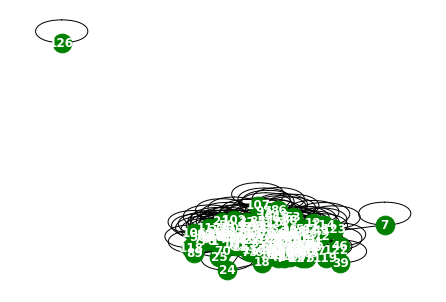

In [326]:
G = nx.Graph()
G.add_edges_from(a.edge_indices[0].T)
nx.draw(G,with_labels=True,font_weight='bold',node_color='green',node_size=350,font_color='white',width=1)

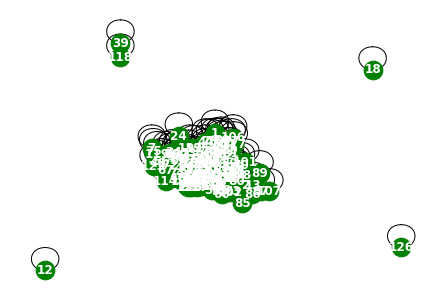

In [327]:
G = nx.Graph()
G.add_edges_from(a.edge_indices[58].T)
nx.draw(G,with_labels=True,font_weight='bold',node_color='green',node_size=350,font_color='white',width=1)

In [224]:
node_list = []
for i in range(0, 129):
    node_list.append(i)

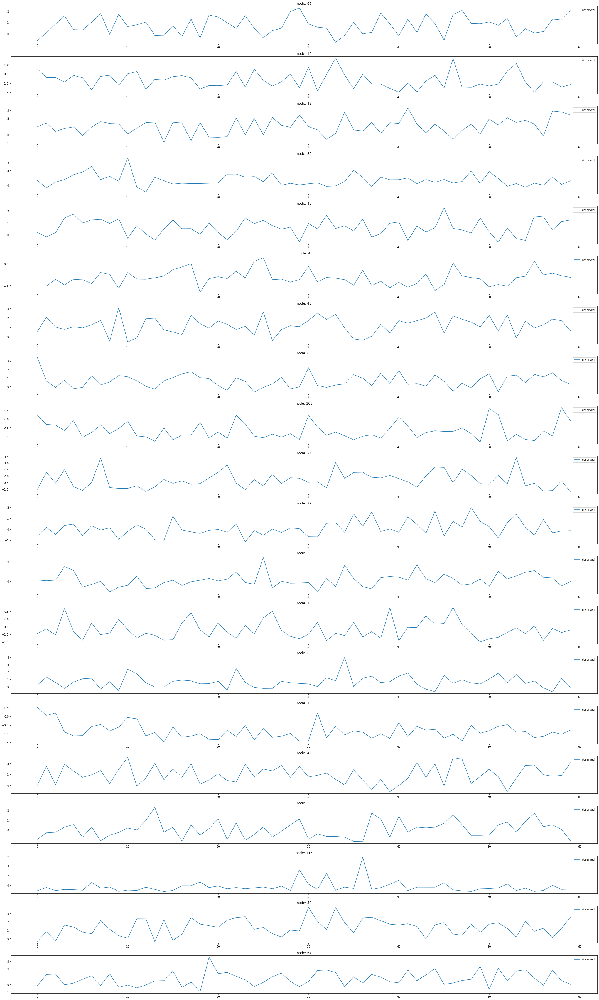

In [225]:
fig, ax = plt.subplots(20, 1, figsize=(30, 50))
indices = random.sample(range(0, 129), 20)
for k, idx in enumerate(indices):
    ax[k].plot(np.array(loader9.targets).reshape(129,-1)[idx], label='observed')
    ax[k].set_title('node: {}'.format(node_list[idx]))
    ax[k].legend()
fig.tight_layout()

## MontevideoBusDatasetLoader

Montevideo Buses

- A dataset of inflow passenger at bus stop level from Montevideo city.    This dataset comprises hourly inflow passenger data at bus stop level for 11 bus lines during October 2020 from Montevideo city (Uruguay). The bus lines selected are the ones that carry people to the center of the city and they load more than 25% of the total daily inflow traffic. Vertices are bus stops, edges are links between bus stops when a bus line connects them and the weight represent the road distance. The target is the passenger inflow. This is a curated dataset made from different data sources of the Metropolitan Transportation System (STM) of Montevideo. These datasets are freely available to anyone in the National Catalog of Open Data from the government of Uruguay (https://catalogodatos.gub.uy/)
- 몬테비데오 시티에서 버스 정류장 층으로 유입된 승객의 데이터 셋
- 2020년 10월 동안 몬테비데오 시티(우루과이)에서 11개 버스 노선에 대한 버스 정류장 수준의 시간당 유입 승객 데이터
- 선정된 버스 노선은 도심까지 사람을 실어 나르는 노선으로 하루 총 유입량의 25% 이상을 적재
- node는 버스 정류장
- edge는 버스 노선이 버스 정류장을 연결할 때 버스 정류장 사이의 링크
- weight는 도로 거리
- target은 승객 유입
- 몬테비데오의 메트로폴리탄 교통 시스템(STM)의 서로 다른 데이터 소스로 만들어진 큐레이션된 데이터 셋

데이터정리 

- T = 743
- V = 버스정류장 
- N = 675 # number of nodes 
- E = 101761 = N^2 # edges 
- $f(v,t)$의 차원? (1,) # passenger inflow 
- 시간에 따라서 Number of nodes가 변하는지? False
- 시간에 따라서 Number of nodes가 변하는지? False
- X: (675,4) (N,4), $f(v,t_0),f(v,t_1),f(v,t_2),f(v,t_3)$
- y: (675,,) (N,), $f(v,t_4)$
- 예제코드적용가능여부: Yes

`-` Nodes : `675`

- vertices are bus stops

`-`Edges : `690`

- edges are links between bus stops when a bus line connects them and the weight represent the road distance

`-` Time : `743`

-  hourly inflow passenger data at bus stop level for 11 bus lines during October 2020 from Montevideo city (Uruguay).

In [599]:
from torch_geometric_temporal.dataset import MontevideoBusDatasetLoader
loader10 = MontevideoBusDatasetLoader()

In [600]:
a = loader10.get_dataset(lags=1)

In [601]:
np.array(a.edge_index).shape

(2, 690)

In [602]:
np.array(a.edge_weight).shape

(690,)

In [603]:
np.array(a.features).shape

(743, 675, 1)

In [604]:
G = nx.Graph()

In [605]:
G.add_edges_from(a.edge_index.T)

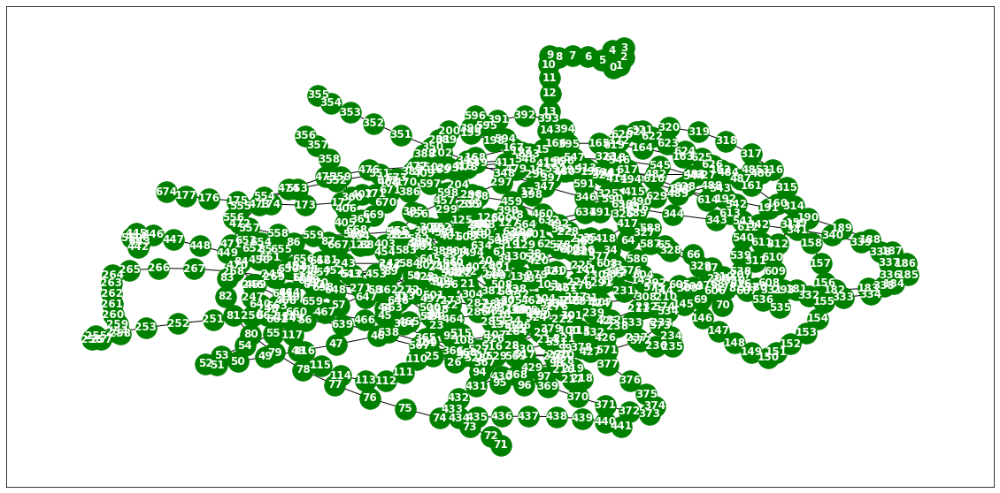

In [606]:
plt.figure(figsize=(20, 10)) 
nx.draw_networkx(G, with_labels=True, font_weight='bold', node_color='green', node_size=550, font_color='white', width=1)
plt.savefig("graph_node_monte.png")

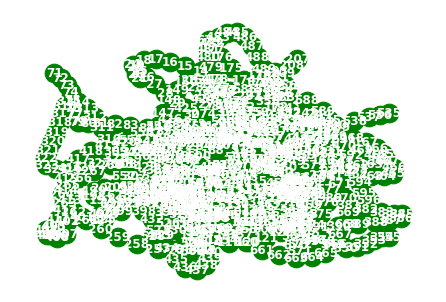

In [81]:
nx.draw(G,with_labels=True,font_weight='bold',node_color='green',node_size=350,font_color='white',width=1)

In [83]:
node_list = []
for i in range(0, 675):
    node_list.append(i)

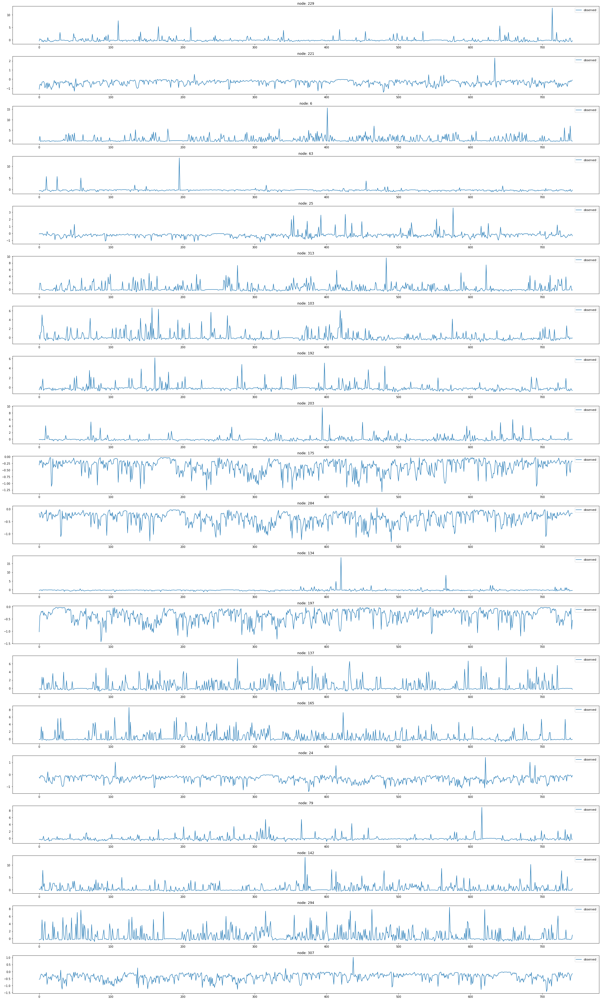

In [106]:
fig, ax = plt.subplots(20, 1, figsize=(30, 50))
indices = random.sample(range(0, 319), 20)
for k, idx in enumerate(indices):
    ax[k].plot(np.array(loader10.targets).reshape(675,-1)[idx], label='observed')
    ax[k].set_title('node: {}'.format(node_list[idx]))
    ax[k].legend()
fig.tight_layout()

In [491]:
x = list(range(a.snapshot_count))
y1 = np.array(a.features)[:, 0, :].reshape(-1)
y2 = np.array(a.features)[:, 1, :].reshape(-1)
y3 = np.array(a.features)[:, 2, :].reshape(-1)
y4 = np.array(a.features)[:, 3, :].reshape(-1)
y5 = np.array(a.features)[:, 4, :].reshape(-1)
y6 = np.array(a.features)[:, 5, :].reshape(-1)

_df = pd.DataFrame({'x': x, 'y1': y1, 'y2': y2, 'y3': y3, 'y4': y4, 'y5': y5, 'y6':y6})

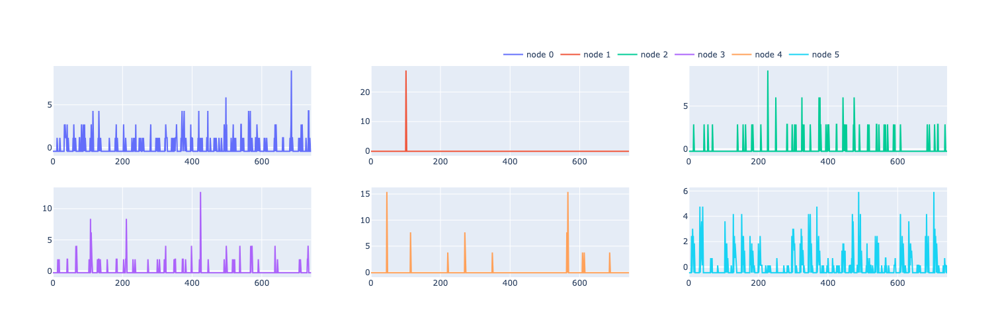

In [492]:
fig = make_subplots(rows=2, cols=3)

# 각 서브플롯에 선 그래프 추가
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y1'], mode='lines', name='node 0'), row=1, col=1)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y2'], mode='lines', name='node 1'), row=1, col=2)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y3'], mode='lines', name='node 2'), row=1, col=3)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y4'], mode='lines', name='node 3'), row=2, col=1)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y5'], mode='lines', name='node 4'), row=2, col=2)
fig.add_trace(go.Scatter(x=_df['x'], y=_df['y6'], mode='lines', name='node 5'), row=2, col=3)

# 그래프 크기 조정
fig.update_layout(width=1000, height=500, legend=dict(x=0.5, y=1.1, orientation='h'))

# 그래프 출력
fig.show()

In [493]:
with open('fig_monte.pkl', 'wb') as file:
    pickle.dump(fig, file)

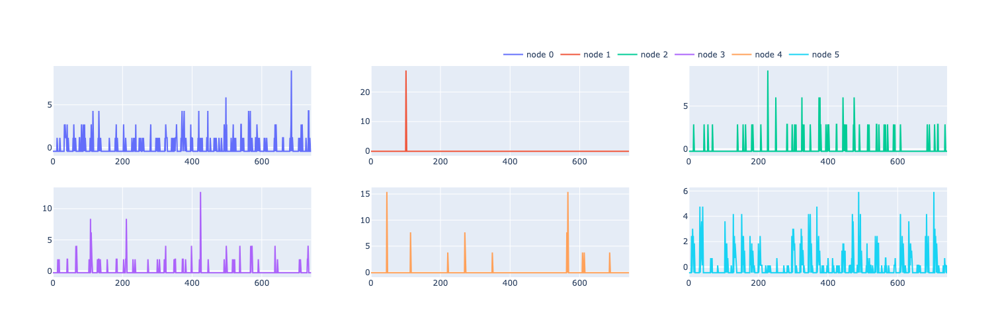

In [494]:
with open("fig_monte.pkl", "rb") as file:
    loaded_object1 = pickle.load(file)

loaded_object1

## TwitterTennisDatasetLoader

https://appliednetsci.springeropen.com/articles/10.1007/s41109-018-0080-5?ref=https://githubhelp.com

Twitter Tennis RG and UO

- Twitter mention graphs of major tennis tournaments from 2017. Each snapshot contains the graph of popular player or sport news accounts and mentions between them [5, 6]. Node labels encode the number of mentions received and vertex features are structural properties

데이터정리 

- T = 52081
- V = 트위터계정  
- N = 1000 # number of nodes 
- E = 119 = N^2 # edges 
- $f(v,t)$의 차원? (1,) # passenger inflow 
- 시간에 따라서 N이 변하는지? ??
- 시간에 따라서 E가 변하는지? True
- X: ?
- y: ?
- 예제코드적용가능여부: No

`-` Nodes : `1000`

- vertices are Twitter accounts

`-`Edges : `119`

- edges are mentions between them

`-` Time : `52081`

- Twitter mention graphs related to major tennis tournaments from 2017

In [66]:
from torch_geometric_temporal.dataset import TwitterTennisDatasetLoader
loader11 = TwitterTennisDatasetLoader()

In [67]:
a = loader11.get_dataset()

In [68]:
a.edge_indices[119]

array([[900, 347, 347, 407, 407, 407, 407, 407, 407,   0,  35, 448, 407,
        396, 396, 370, 233, 233, 357,  15,  15, 135, 135, 358, 233, 233,
        243, 115, 115, 667, 667, 667, 667, 440, 440, 440, 101, 650, 309,
        309, 309, 233, 347, 347, 974, 161, 218, 309, 309,  93,  93, 813,
        101, 417,  69,  69, 480, 480, 416, 272, 813, 813, 813, 379, 903,
        903, 903,  95, 309, 309, 309, 144, 890, 890, 484, 484, 484, 653,
        653, 234, 234, 234, 253, 253, 630, 769, 769, 156, 156, 156, 892,
        912, 912,   0, 278, 896, 896, 896, 233,  92,  69, 802, 324, 324,
        574,  87,  87,  87, 365, 365,  87, 522, 611, 427, 427, 427, 110,
        246, 246, 445, 156, 156, 133, 133, 217, 217,   4,   4, 105, 105,
        105, 105, 630, 630, 630, 792,  84, 452,  51,  84, 445, 613, 985,
        290, 290, 290, 290, 290, 290, 420, 420, 420, 420, 420, 420, 420,
        420, 420,   0, 626, 626, 519, 519, 519, 519, 519, 519, 519, 519,
        519, 217, 437, 437, 437, 309, 309, 217, 666

In [69]:
a.edge_weights[119]

array([1, 3, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 6, 2, 2, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 2, 2, 1, 1, 1, 1, 1, 1, 3, 3, 1, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 3, 1, 1, 2, 2, 2, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 2, 1, 1, 3, 3, 1,
       3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [70]:
a.features[119]

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.]])

In [71]:
a.snapshot_count

120

In [72]:
np.array(a.targets).shape

(120, 1000)

In [73]:
node_list = []
for i in range(0, 1000):
    node_list.append(i)

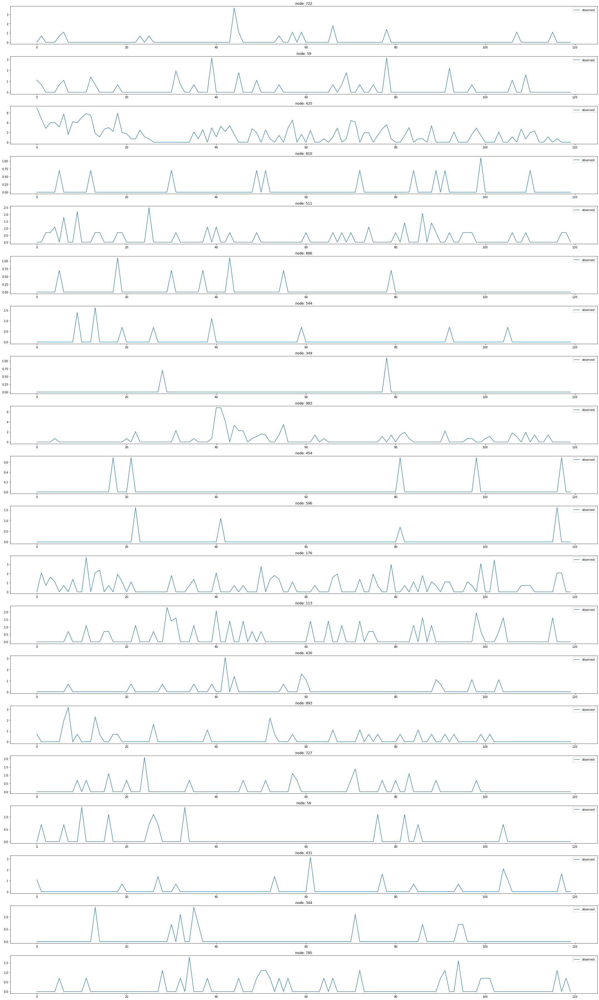

In [74]:
fig, ax = plt.subplots(20, 1, figsize=(30, 50))
indices = random.sample(range(0, 1000), 20)
for k, idx in enumerate(indices):
    ax[k].plot(np.array(loader11.targets).reshape(1000,-1)[idx], label='observed')
    ax[k].set_title('node: {}'.format(node_list[idx]))
    ax[k].legend()
fig.tight_layout()

In [75]:
def transform_degree(x, cutoff=4):
    log_deg = np.ceil(np.log(x + 1.0))
    return np.minimum(log_deg, cutoff)


def transform_transitivity(x):
    trans = x * 10
    return np.floor(trans)


def onehot_encoding(x, unique_vals):
    E = np.zeros((len(x), len(unique_vals)))
    for i, val in enumerate(x):
        E[i, unique_vals.index(val)] = 1.0
    return E


def encode_features(X, log_degree_cutoff=4):
    X_arr = np.array(X)
    a = transform_degree(X_arr[:, 0], log_degree_cutoff)
    b = transform_transitivity(X_arr[:, 1])
    A = onehot_encoding(a, range(log_degree_cutoff + 1))
    B = onehot_encoding(b, range(11))
    return np.concatenate((A, B), axis=1)

## MTMDatasetLoader

MTM-1 Hand Motions

-   A dataset of `Methods-Time Measurement-1 <https://en.wikipedia.org/wiki/Methods-time_measurement>`_(MTM-1) motions, signalled as consecutive video frames of 21 3D hand keypoints, acquired via `MediaPipe Hands <https://google.github.io/mediapipe/solutions/hands.html>`_ from RGB-Video material. Vertices are the finger joints of the human hand and edges are the bones connecting them. The targets are manually labeled for each frame, according to one of the five MTM-1 motions (classes :math:`C`): Grasp, Release, Move, Reach, Position plus a negative class for frames without graph signals (no hand present). This is a classification task where :math:`T` consecutive frames need to be assigned to the corresponding class :math:`C`. The data x is returned in shape :obj:`(3, 21, T)`, the target is returned one-hot-encoded in shape :obj:`(T, 6)`.

데이터정리 

- T = 14452
- V = 손의 shape에 대응하는 dot    
- N = 325 # number of nodes 
- E = 19 = N^2 # edges 
- $f(v,t)$의 차원? (Grasp, Release, Move, Reach, Poision, -1)
- 시간에 따라서 N이 변하는지? ??
- 시간에 따라서 E가 변하는지? ??
- X: ?
- y: ?
- 예제코드적용가능여부: No

`-` Nodes : `325`

- vertices are are the finger joints of the human hand

`-`Edges : `19`

- edges are the bones connecting them

`-` Time : `14452`

In [32]:
 # target eoncoding: {0 : 'Grasp', 1 : 'Move', 2 : 'Negative',
        #                   3 : 'Position', 4 : 'Reach', 5 : 'Release'}

In [33]:
from torch_geometric_temporal.dataset import MTMDatasetLoader
loader12 = MTMDatasetLoader()

In [34]:
a = loader12.get_dataset(frames=16)

In [35]:
np.array(a.edge_index).shape

(2, 19)

In [36]:
np.shape(a.edge_weight)

(19,)

In [37]:
np.array(a.features).shape

(14453, 3, 21, 16)

In [38]:
a.snapshot_count

14453

In [39]:
np.array(a.targets).shape

(14453, 16, 6)

In [48]:
a.targets[0]

array([[0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.]])

In [41]:
b=[]
for i in range(a.snapshot_count):
    b.append(np.argmax(a.targets[i]))

In [42]:
pd.DataFrame(b)[0].unique()

array([2, 4, 0, 1, 3, 5])

In [43]:
pd.DataFrame(b).value_counts()

0    3910
1    3189
3    3069
4    2480
2    1266
5     539
dtype: int64